# UFABC - ESTI019 - Codificação de Sinais Multimídia
<h2> Laboratório 6 - Seção de PDS da Voz </h2>
<h3> Prof. Mário Minami </h2>
<h2> OBJETIVOS: </h2>
<ol>
<li> Analisar arquivos de Áudio com dígitos, números gerais, texto lido e poesia </li>
<li> Leitura de Arquivos de Áudio e janelamento</li>
<li> Cálculo das Energias de Tempo Curto</li>
<li> Cálculo dos Espectrogramas</li>
<li> Determinação do Pitch, da Frequência Fundamental e das Formantes ($f_1$ a $f_4$) de Algumas Vogais</li>
<li>Determinação de fonemas surdos, sonoros, consoantes gerais e plosivos</li>
</ol>

##<h2> 1. Subir os arquivos de Áudio com dígitos, números gerais, texto lido e poesia </h2>

Suba os arquivos com:
<ul>
<li> Dígitos (pronunciados separadamente) </li>
<li> Números Gerais (p.ex. dia/mês/ano de nascimento, nº celular, RA)</li>
<li> Texto lido </li>
<li> Poesia declamada </li>
</ul>


##<h2> 2. Leitura de Arquivos de Áudio e janelamento </h2>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import librosa
import librosa.display
import IPython.display
#OBS.: insira nome do arquivo WAV
audio1 = '/content/drive/My Drive/Colab Notebooks/LAB6/Entre_Leva_Catia_Falada.wav'
print(audio1)
v1 , sr1 = librosa.load(audio1)
# Imprime tempo e sample rate
print(type(v1), type(sr1))
print(v1.shape, sr1)
# Player será aberto! AGUARDE até abrir!
IPython.display.Audio(data=v1, rate=sr1)

/content/drive/My Drive/Colab Notebooks/LAB6/Entre_Leva_Catia_Falada.wav
<class 'numpy.ndarray'> <class 'int'>
(292805,) 22050


Text(0.5, 1.0, 'Voz da Catia/content/drive/My Drive/Colab Notebooks/LAB6/Entre_Leva_Catia_Falada.wav')

<Figure size 432x288 with 0 Axes>

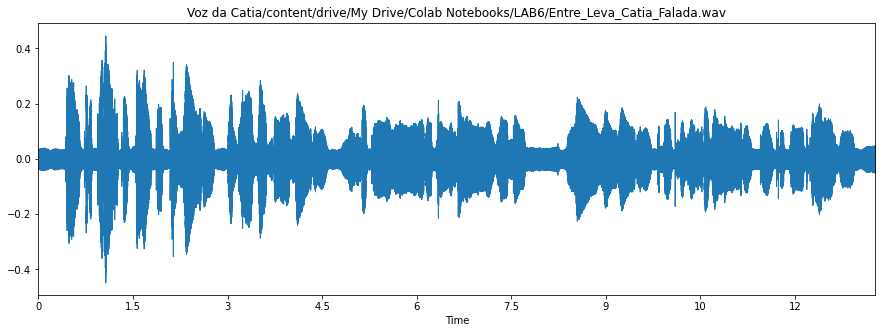

In [ ]:
plt.figure()
fig, ax = plt.subplots(figsize=(15, 5))
librosa.display.waveplot(v1, sr=sr1)
plt.title('Voz da Catia' + audio1)

### 2.1 Definição dos Parâmetros da Análise 

In [ ]:
print('Frequência de Amostragem', sr1)

Frequência de Amostragem 22050


In [ ]:
fa = sr1
print(fa)

22050


In [ ]:
Ts = 0.04   # Tempo de duração do segmento em segundos
Nj = int(Ts*fa) # Número de pontos da Janela
print('Tamanho do Segmento', Nj)

Tamanho do Segmento 882


In [ ]:
Nseg = int(len(v1)/Nj)
Nover = int(Nj*0.5)
print('Número de Segmentos no Arquivo', Nseg, '. Pontos Soprepostos', Nover )

Número de Segmentos no Arquivo 331 . Pontos Soprepostos 441


<h3> 2.2 Obtendo uma Janela de Hamming </h3>

Text(0.5, 1.0, 'Janela de Hamming')

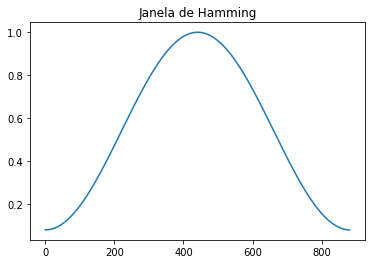

In [ ]:
from scipy import signal
hm = signal.get_window('hamming', Nj)
plt.plot(hm); plt.title('Janela de Hamming')

<h2> 3. Energia de Tempo Curto </h2>

### 3.1 Cálculo para arquivo de teste 

Text(0.5, 0, 'Segmento')

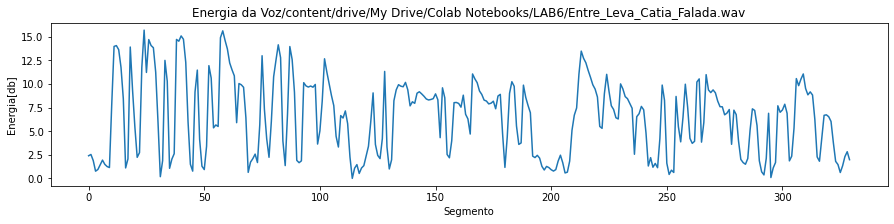

In [ ]:
Nover = int(Nj*0.5)
Nseg = int(len(v1)/Nj)
E = []
for l in range(1, Nseg):
    xjan = v1[(l-1)*Nj+Nover:l*Nj+Nover]*hm
    x2 = list(np.array(xjan**2))
    aux = sum(x2)/Nj
    E.append(aux)
E = 10*np.log10(E)
Emin = np.min(E)  # calcula nível de ruído de fundo
plt.figure
fig, ax = plt.subplots(figsize=(15, 3))
plt.plot(E - Emin)
plt.title('Energia da Voz' + audio1)
plt.ylabel('Energia[db]'); plt.xlabel('Segmento')

## 3.2 Agora leia os seus arquivos gravados e: 
**Determine o Contorno de Energia para três arquivos (todos os integrantes devem fazer a análise que gravaram):** 
1. *dígitos*
2. *voz falada*
3. *voz declamada (poema)*




###3.2.1 - Digitos

####Audios

In [ ]:
#funcao para facilitar a importacao dos arquivos
def input_data_microComun(filename):
  #carrega o arquivo de audio
    v2, sr2 = librosa.load('/content/drive/MyDrive/Colab Notebooks/LAB6/Microfone Comum/'+f'{filename}.wav')
    #imprime o nome
    print(f'Arquivo: {filename}.wav')
    #imprime o n de amostras e sample rate
    print(f'n_samples: {v2.shape}\nSampling rate: {sr2}')
    #retorna um vertor com o nome do arquivo, n de amostras e sample rate
    return filename, v2, sr2

In [ ]:
audioDigArtur = input_data_microComun('RA11042511') #carrega arquivo
IPython.display.Audio(data=audioDigArtur[1], rate=audioDigArtur[2])  #player será aberto

Arquivo: RA11042511.wav
n_samples: (149134,)
Sampling rate: 22050


In [ ]:
audioDigWell = input_data_microComun('RA11075113') #carrega arquivo
IPython.display.Audio(data=audioDigWell[1], rate=audioDigWell[2])  #player será aberto

Arquivo: RA11075113.wav
n_samples: (167054,)
Sampling rate: 22050


In [ ]:
audioDigCesar = input_data_microComun('RA11127015') #carrega arquivo
IPython.display.Audio(data=audioDigCesar[1], rate=audioDigCesar[2])  #player será aberto

Arquivo: RA11127015.wav
n_samples: (117454,)
Sampling rate: 22050


In [ ]:
audioDigEric = input_data_microComun('RA11201720512') #carrega arquivo
IPython.display.Audio(data=audioDigEric[1], rate=audioDigEric[2])  #player será aberto

Arquivo: RA11201720512.wav
n_samples: (236814,)
Sampling rate: 22050


In [ ]:
audioDigJulia = input_data_microComun('RA11201721522') #carrega arquivo
IPython.display.Audio(data=audioDigJulia[1], rate=audioDigJulia[2])  #player será aberto

Arquivo: RA11201721522.wav
n_samples: (237454,)
Sampling rate: 22050


####Janelamento

In [ ]:
def plotSinalTempo(nome, audio):
    fig, ax = plt.subplots(figsize=(12, 3))
    librosa.display.waveplot(audio[1], sr=audio[2])
    plt.title(f'Voz de {nome} - ' + str(audio[0]))
    plt.show()

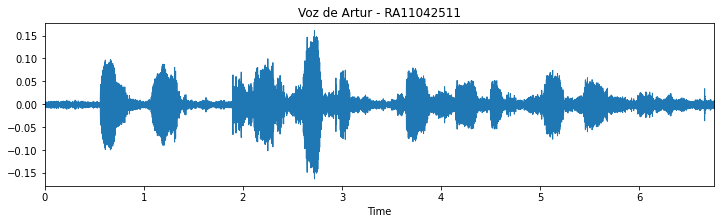

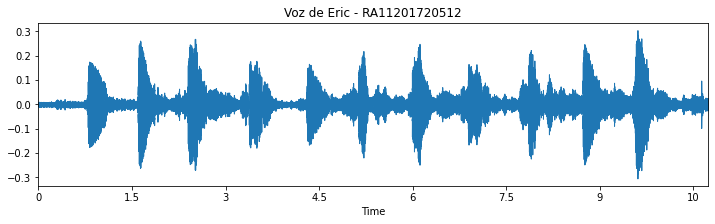

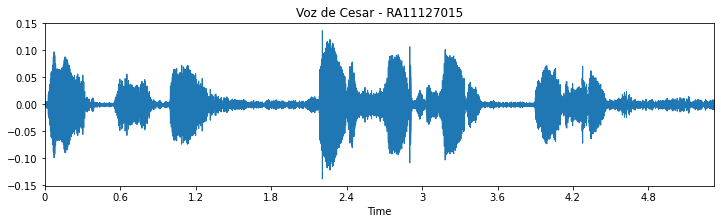

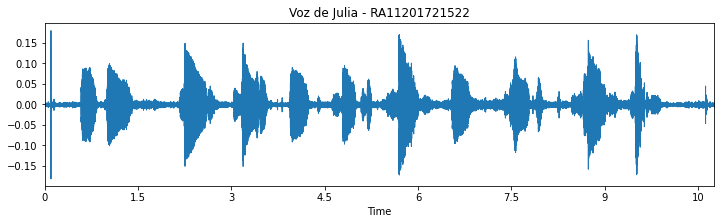

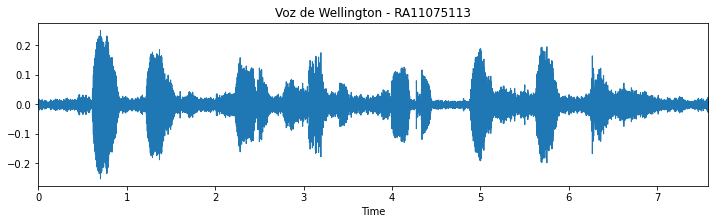

In [ ]:
plotSinalTempo('Artur',audioDigArtur)
plotSinalTempo('Eric',audioDigEric)
plotSinalTempo('Cesar',audioDigCesar)
plotSinalTempo('Julia',audioDigJulia)
plotSinalTempo('Wellington',audioDigWell)

####Definição de parametros

In [ ]:
def parametros_analise(audio):
    print(audio[0])
    print('Frequência de Amostragem:', audio[2])

    Ts = 0.04   # Tempo de duração do segmento em segundos
    Nj = int(Ts*audio[2]) # Número de pontos da Janela
    print('Tamanho do Segmento:', Nj)

    Nseg = int(len(audio[1])/Nj)
    Nover = int(Nj*0.5)
    print(f'Número de Segmentos no Arquivo: {Nseg}\nPontos Soprepostos: {Nover}\n' )
    
    return Nj

In [ ]:
Nj_texto = (parametros_analise(audioDigArtur),
            parametros_analise(audioDigEric),
            parametros_analise(audioDigCesar),
            parametros_analise(audioDigJulia),
            parametros_analise(audioDigWell))
Nj = Nj_texto[0]

RA11042511
Frequência de Amostragem: 22050
Tamanho do Segmento: 882
Número de Segmentos no Arquivo: 169
Pontos Soprepostos: 441

RA11201720512
Frequência de Amostragem: 22050
Tamanho do Segmento: 882
Número de Segmentos no Arquivo: 268
Pontos Soprepostos: 441

RA11127015
Frequência de Amostragem: 22050
Tamanho do Segmento: 882
Número de Segmentos no Arquivo: 133
Pontos Soprepostos: 441

RA11201721522
Frequência de Amostragem: 22050
Tamanho do Segmento: 882
Número de Segmentos no Arquivo: 269
Pontos Soprepostos: 441

RA11075113
Frequência de Amostragem: 22050
Tamanho do Segmento: 882
Número de Segmentos no Arquivo: 189
Pontos Soprepostos: 441



#####Janela de Hamming

Text(0.5, 1.0, 'Janela de Hamming')

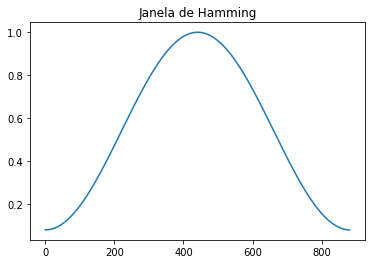

In [ ]:
#um dado qualquer para a janela de hamming, já que todos tem o mesmo tamanho de segmento
hm = signal.get_window('hamming', Nj_texto[0])
plt.plot(hm); plt.title('Janela de Hamming')

####Energia de Tempo Curto

In [ ]:
def energia(audio,Nj):
    Nover = int(Nj*0.5)
    Nseg = int(len(audio[1])/Nj)
    E = []
    for l in range(1, Nseg):
        xjan = audio[1][(l-1)*Nj+Nover:l*Nj+Nover]*hm
        x2 = list(np.array(xjan**2))
        aux = sum(x2)/Nj
        E.append(aux)
    E = 10*np.log10(E)
    Emin = np.min(E)  # calcula nível de ruído de fundo
    plt.figure
    fig, ax = plt.subplots(figsize=(15, 3))
    plt.plot(E - Emin)
    plt.title('Energia da Voz - ' + str(audio[0]))
    plt.ylabel('Energia[db]'); plt.xlabel('Segmento')

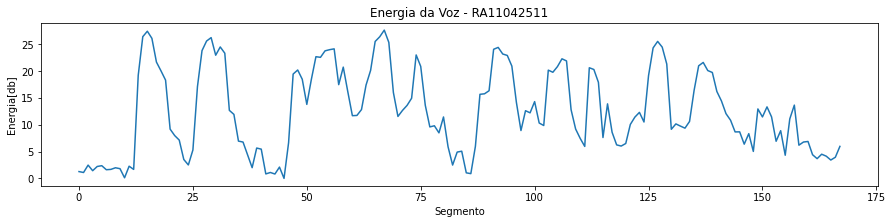

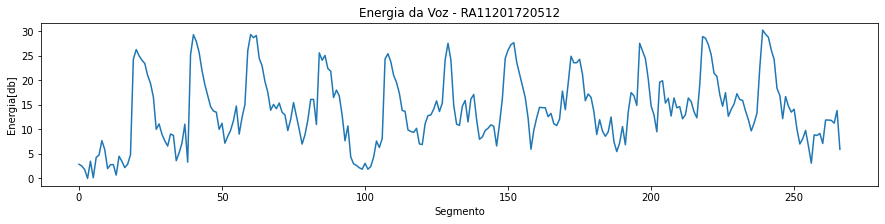

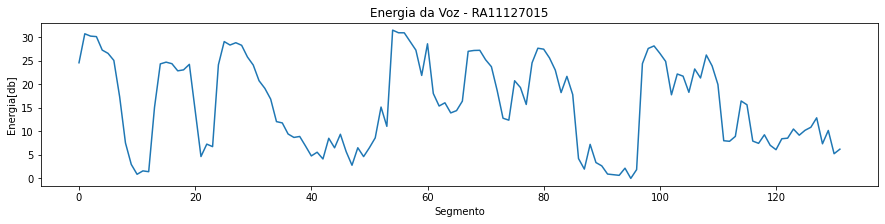

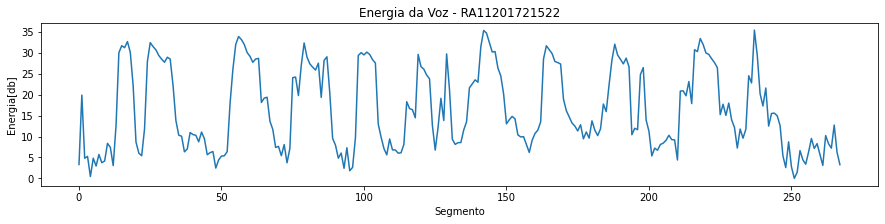

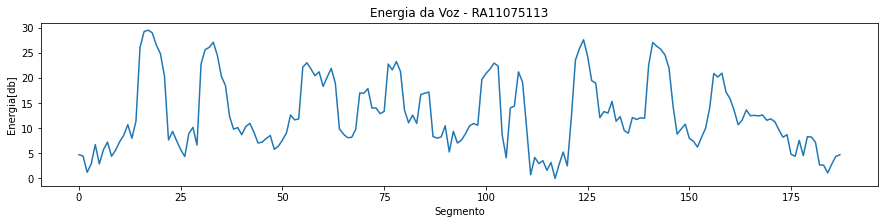

In [ ]:
energia(audioDigArtur, Nj)
energia(audioDigEric, Nj)
energia(audioDigCesar, Nj)
energia(audioDigJulia, Nj)
energia(audioDigWell, Nj)

###3.2.2 - Voz Falada

####Audios

In [ ]:
audioVFArtur = input_data_microComun('FraseArtur')
IPython.display.Audio(data=audioVFArtur[1], rate=audioVFArtur[2])  #player será aberto

Arquivo: FraseArtur.wav
n_samples: (115534,)
Sampling rate: 22050


In [ ]:
audioVFEric = input_data_microComun('FraseEric')
IPython.display.Audio(data=audioVFEric[1], rate=audioVFEric[2])  #player será aberto

Arquivo: FraseEric.wav
n_samples: (103424,)
Sampling rate: 22050


In [ ]:
audioVFCesar = input_data_microComun('FraseCesar')
IPython.display.Audio(data=audioVFCesar[1], rate=audioVFCesar[2])  #player será aberto

Arquivo: FraseCesar.wav
n_samples: (81614,)
Sampling rate: 22050


In [ ]:
audioVFJulia = input_data_microComun('FraseJulia')
IPython.display.Audio(data=audioVFJulia[1], rate=audioVFJulia[2])  #player será aberto

Arquivo: FraseJulia.wav
n_samples: (96512,)
Sampling rate: 22050


In [ ]:
audioVFWell = input_data_microComun('FraseWellington')
IPython.display.Audio(data=audioVFWell[1], rate=audioVFWell[2])  #player será aberto

Arquivo: FraseWellington.wav
n_samples: (97934,)
Sampling rate: 22050


####Janelamento

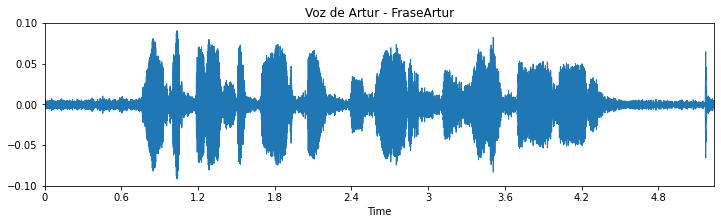

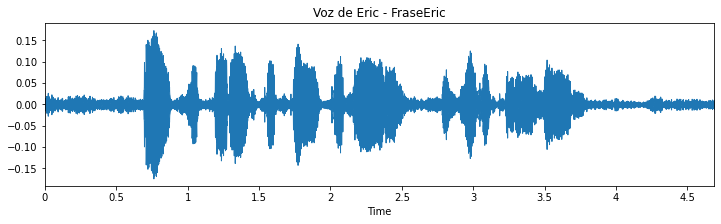

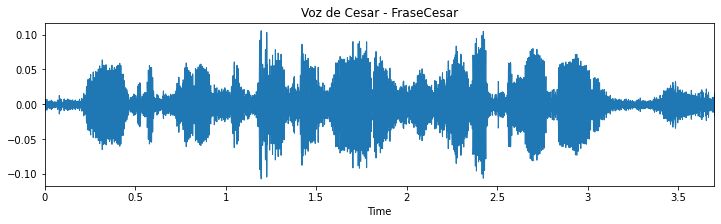

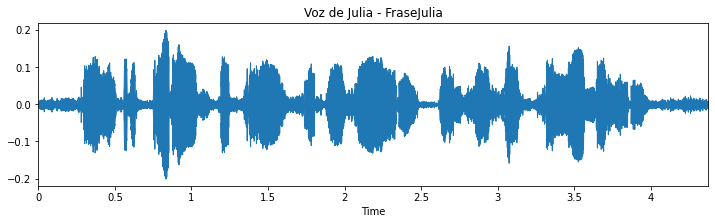

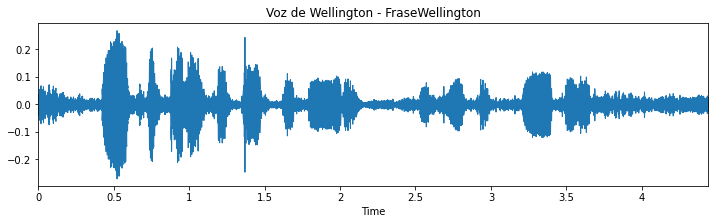

In [ ]:
plotSinalTempo('Artur',audioVFArtur)
plotSinalTempo('Eric',audioVFEric)
plotSinalTempo('Cesar',audioVFCesar)
plotSinalTempo('Julia',audioVFJulia)
plotSinalTempo('Wellington',audioVFWell)

####Definição de parametros

In [ ]:
Nj_texto = (parametros_analise(audioVFArtur),
            parametros_analise(audioVFEric),
            parametros_analise(audioVFCesar),
            parametros_analise(audioVFJulia),
            parametros_analise(audioVFWell))
Nj = Nj_texto[0]

FraseArtur
Frequência de Amostragem: 22050
Tamanho do Segmento: 882
Número de Segmentos no Arquivo: 130
Pontos Soprepostos: 441

FraseEric
Frequência de Amostragem: 22050
Tamanho do Segmento: 882
Número de Segmentos no Arquivo: 117
Pontos Soprepostos: 441

FraseCesar
Frequência de Amostragem: 22050
Tamanho do Segmento: 882
Número de Segmentos no Arquivo: 92
Pontos Soprepostos: 441

FraseJulia
Frequência de Amostragem: 22050
Tamanho do Segmento: 882
Número de Segmentos no Arquivo: 109
Pontos Soprepostos: 441

FraseWellington
Frequência de Amostragem: 22050
Tamanho do Segmento: 882
Número de Segmentos no Arquivo: 111
Pontos Soprepostos: 441



#####Janela de Hamming

Text(0.5, 1.0, 'Janela de Hamming')

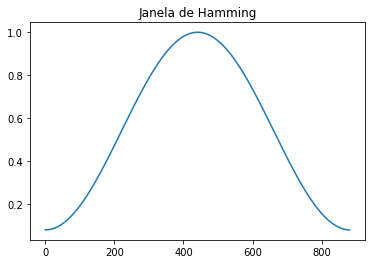

In [ ]:
#um dado qualquer para a janela de hamming, já que todos tem o mesmo tamanho de segmento
hm = signal.get_window('hamming', Nj_texto[0])
plt.plot(hm); plt.title('Janela de Hamming')

####Energia de Tempo Curto

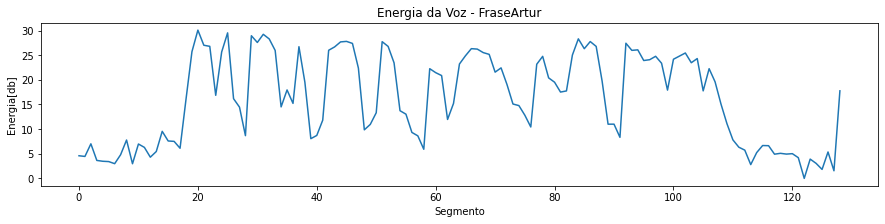

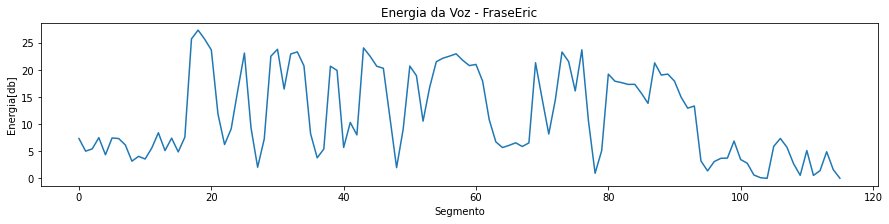

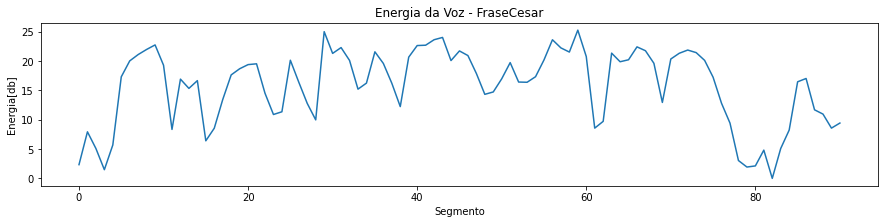

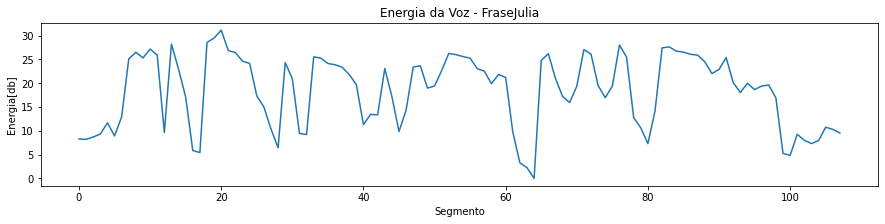

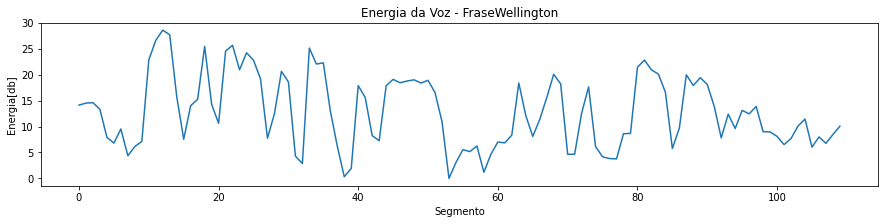

In [ ]:
energia(audioVFArtur, Nj)
energia(audioVFEric, Nj)
energia(audioVFCesar, Nj)
energia(audioVFJulia, Nj)
energia(audioVFWell, Nj)

###3.2.3 - Voz Declamada (Poesia)

####Audios

In [ ]:
audioVDArtur = input_data_microComun('CamoesArtur') #carrega arquivo
IPython.display.Audio(data=audioVDArtur[1], rate=audioVDArtur[2])  #player será aberto

Arquivo: CamoesArtur.wav
n_samples: (174336,)
Sampling rate: 22050


In [ ]:
audioVDEric = input_data_microComun('CamoesEric') #carrega arquivo
IPython.display.Audio(data=audioVDEric[1], rate=audioVDEric[2])  #player será aberto

Arquivo: CamoesEric.wav
n_samples: (183054,)
Sampling rate: 22050


In [ ]:
audioVDCesar = input_data_microComun('CamoesCesarSeiji') #carrega arquivo
IPython.display.Audio(data=audioVDCesar[1], rate=audioVDCesar[2])  #player será aberto

Arquivo: CamoesCesarSeiji.wav
n_samples: (229454,)
Sampling rate: 22050


In [ ]:
audioVDJulia = input_data_microComun('CamoesJuliaPolaSilva') #carrega arquivo
IPython.display.Audio(data=audioVDJulia[1], rate=audioVDJulia[2])  #player será aberto

Arquivo: CamoesJuliaPolaSilva.wav
n_samples: (168448,)
Sampling rate: 22050


In [ ]:
audioVDWell = input_data_microComun('CamoesWellingtonAraujoNogueira') #carrega arquivo
IPython.display.Audio(data=audioVDWell[1], rate=audioVDWell[2])  #player será aberto

Arquivo: CamoesWellingtonAraujoNogueira.wav
n_samples: (168270,)
Sampling rate: 22050


####Janelamento

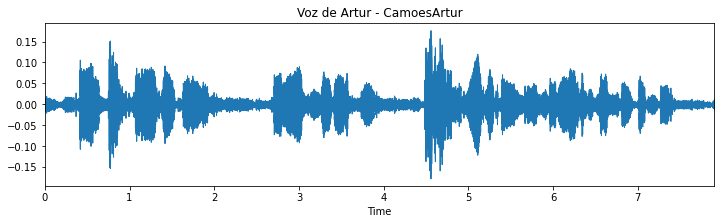

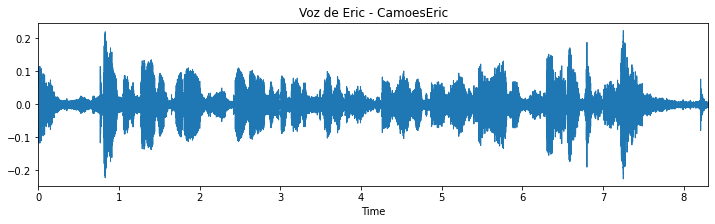

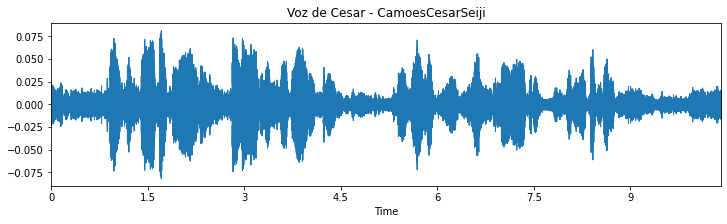

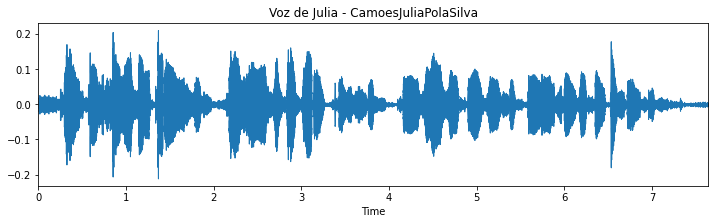

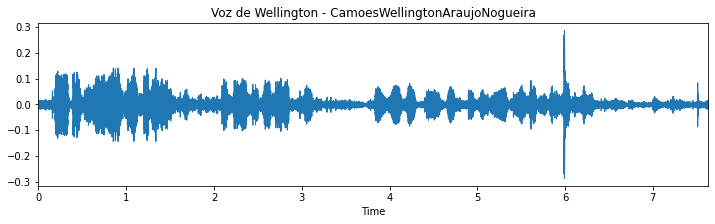

In [ ]:
plotSinalTempo('Artur',audioVDArtur)
plotSinalTempo('Eric',audioVDEric)
plotSinalTempo('Cesar',audioVDCesar)
plotSinalTempo('Julia',audioVDJulia)
plotSinalTempo('Wellington',audioVDWell)

####Definição de parametros

In [ ]:
Nj_texto = (parametros_analise(audioVDArtur),
            parametros_analise(audioVDEric),
            parametros_analise(audioVDCesar),
            parametros_analise(audioVDJulia),
            parametros_analise(audioVDWell))
Nj = Nj_texto[0]

CamoesArtur
Frequência de Amostragem: 22050
Tamanho do Segmento: 882
Número de Segmentos no Arquivo: 197
Pontos Soprepostos: 441

CamoesEric
Frequência de Amostragem: 22050
Tamanho do Segmento: 882
Número de Segmentos no Arquivo: 207
Pontos Soprepostos: 441

CamoesCesarSeiji
Frequência de Amostragem: 22050
Tamanho do Segmento: 882
Número de Segmentos no Arquivo: 260
Pontos Soprepostos: 441

CamoesJuliaPolaSilva
Frequência de Amostragem: 22050
Tamanho do Segmento: 882
Número de Segmentos no Arquivo: 190
Pontos Soprepostos: 441

CamoesWellingtonAraujoNogueira
Frequência de Amostragem: 22050
Tamanho do Segmento: 882
Número de Segmentos no Arquivo: 190
Pontos Soprepostos: 441



#####Janela de Hamming

Text(0.5, 1.0, 'Janela de Hamming')

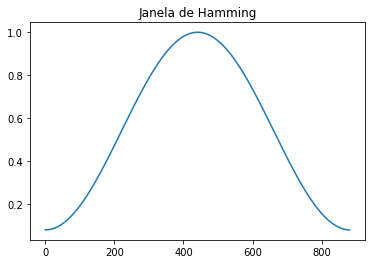

In [ ]:
#um dado qualquer para a janela de hamming, já que todos tem o mesmo tamanho de segmento
hm = signal.get_window('hamming', Nj_texto[0])
plt.plot(hm); plt.title('Janela de Hamming')

####Energia de Tempo Curto

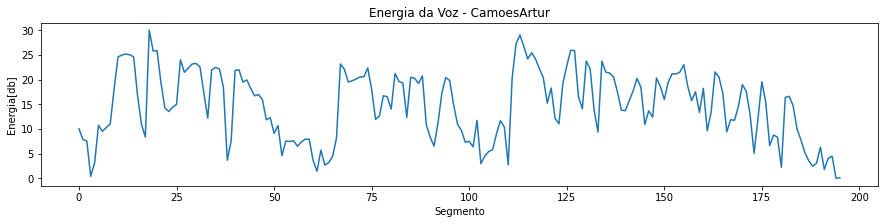

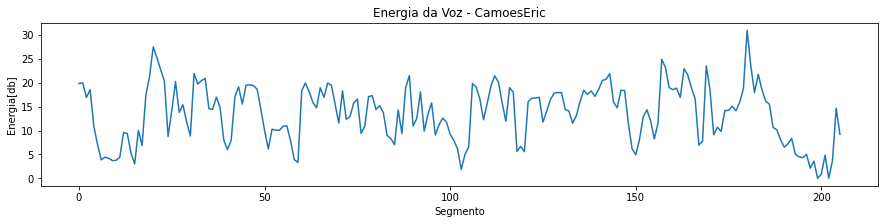

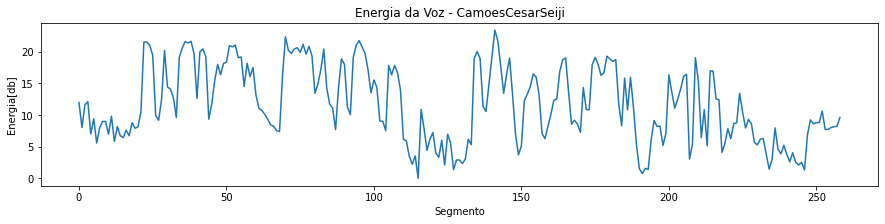

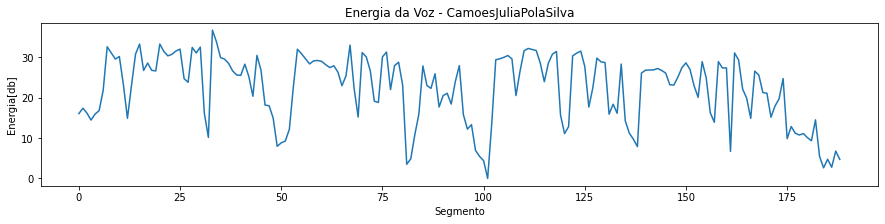

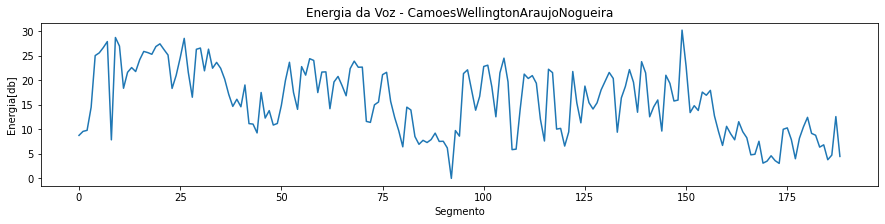

In [ ]:
energia(audioVDArtur, Nj)
energia(audioVDEric, Nj)
energia(audioVDCesar, Nj)
energia(audioVDJulia, Nj)
energia(audioVDWell, Nj)

##<h2> 4. Espectrogramas </h2>

### 4.1 Visualização do Espectrograma para Arquivo de Teste

Text(0.5, 1.0, 'Potência e Espectrograma Linear na Frequência/content/drive/My Drive/Colab Notebooks/LAB6/Entre_Leva_Catia_Falada.wav')

<Figure size 864x576 with 0 Axes>

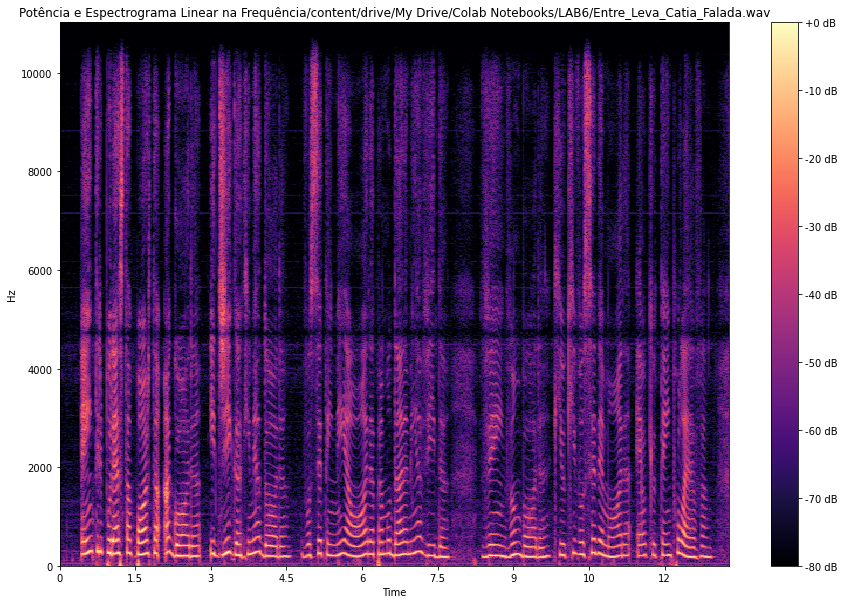

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(12, 8))
D = librosa.amplitude_to_db(np.abs(librosa.stft(v1)), ref=np.max)
fig, ax = plt.subplots(figsize=(15, 10))
librosa.display.specshow(D, x_axis='time',y_axis='linear')
plt.colorbar(format='%+2.0f dB')
plt.title('Potência e Espectrograma Linear na Frequência'+ audio1)

### 4.2 Agora com os seus arquivos
**Faça os espectrogramas para os arquivos que vocês gravaram (todos novamente) e calculem o contorno de energia:**
<ul>
<li> Dígitos </li>
<li> Texto Lido </li>
<li> Poesia </li>
</ul>

#### 4.2.1 Espectograma dos digitos


In [ ]:
#funcao para facilitar o plot do espectro e sua potencia
def plot_especto(vetor):
  D = librosa.amplitude_to_db(np.abs(librosa.stft(vetor[1])), ref=np.max)
  fig, ax = plt.subplots(figsize=(15, 10))
  librosa.display.specshow(D, x_axis='time',y_axis='linear')
  plt.colorbar(format='%+2.0f dB')
  plt.title('Potência e Espectrograma Linear na Frequência '+ vetor[0])

RA Artur:


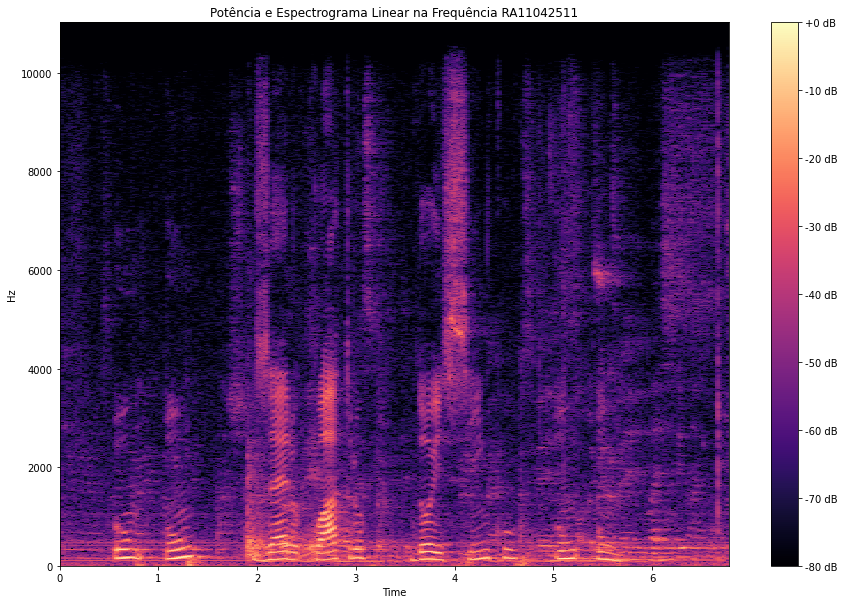

In [ ]:
print('RA Artur:')
plot_especto(audioDigArtur)

RA Eric:


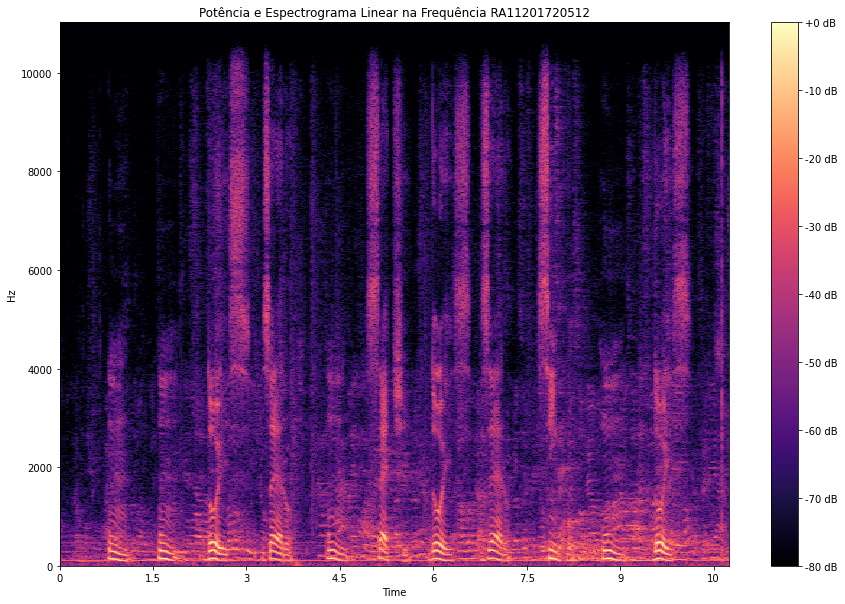

In [ ]:
print('RA Eric:')
plot_especto(audioDigEric)

RA Cesar:


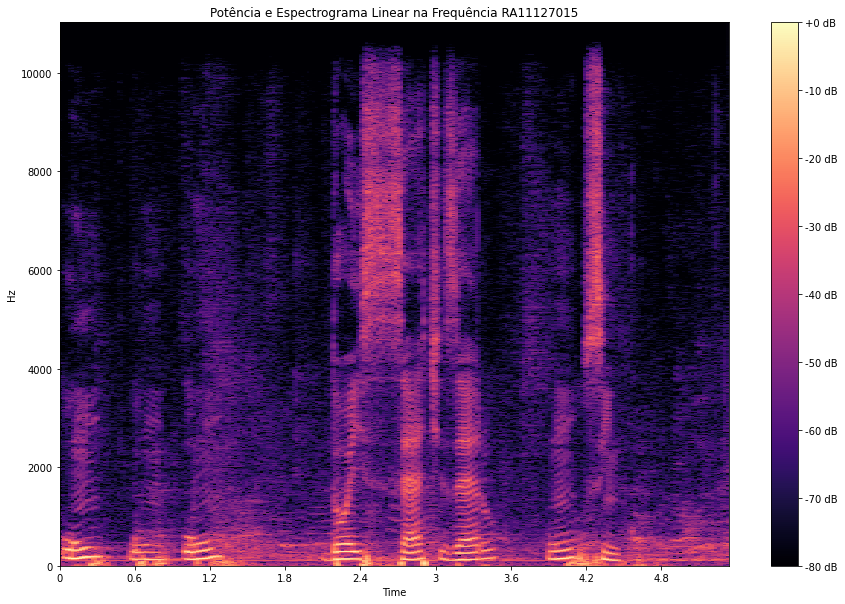

In [ ]:
print('RA Cesar:')
plot_especto(audioDigCesar)

RA Julia:


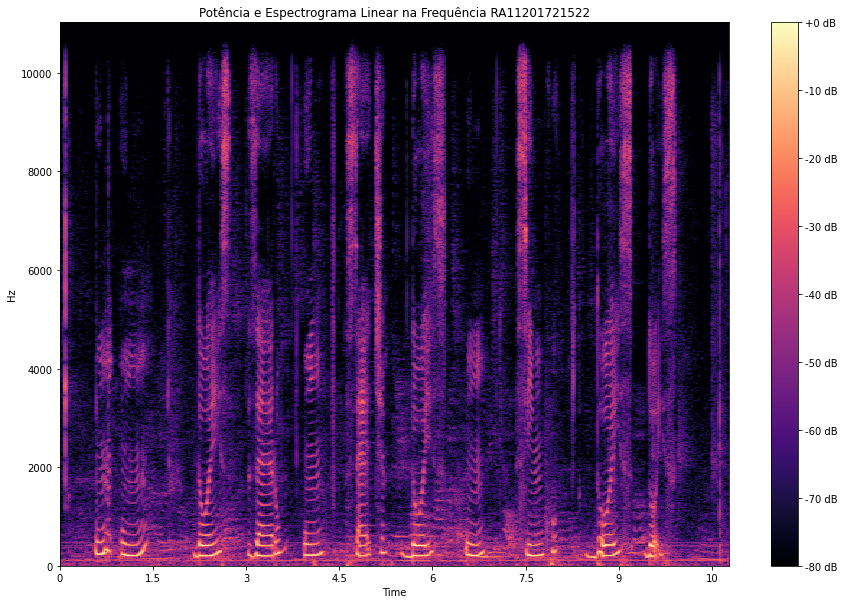

In [ ]:
print('RA Julia:')
plot_especto(audioDigJulia)

RA Wellington:


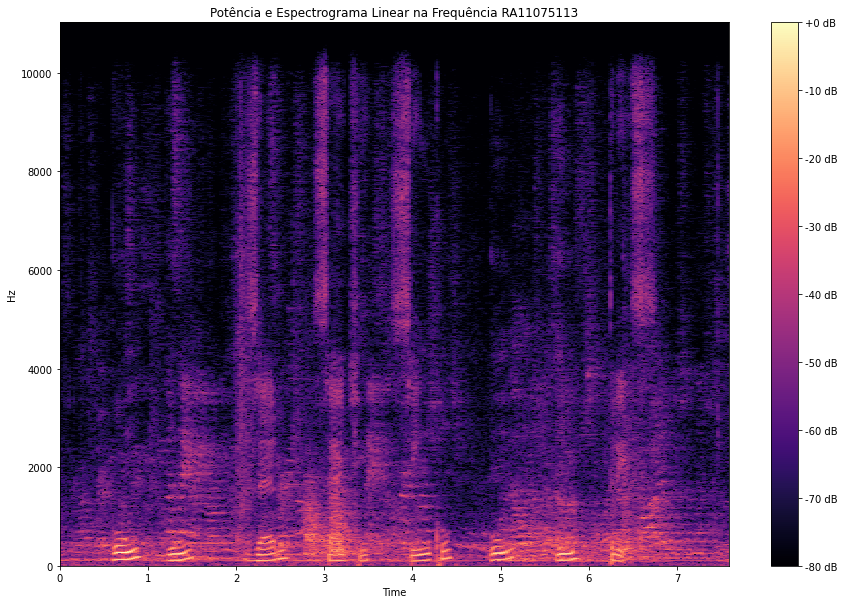

In [ ]:
print('RA Wellington:')
plot_especto(audioDigWell)

#### 4.2.2 Espectograma da voz falada


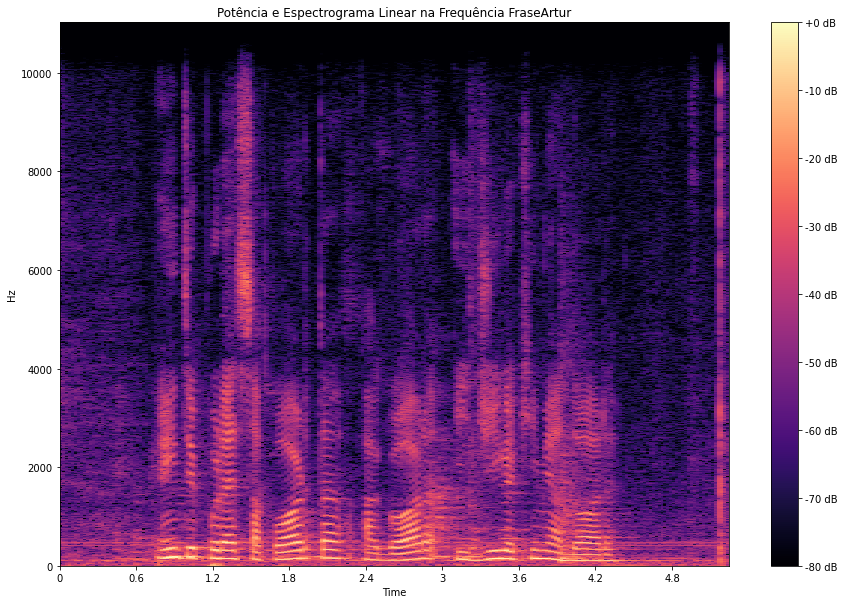

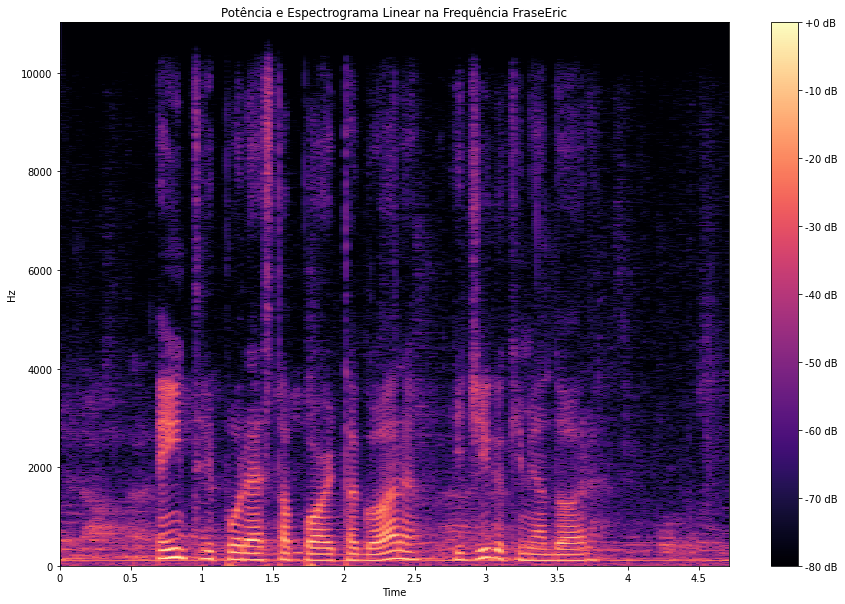

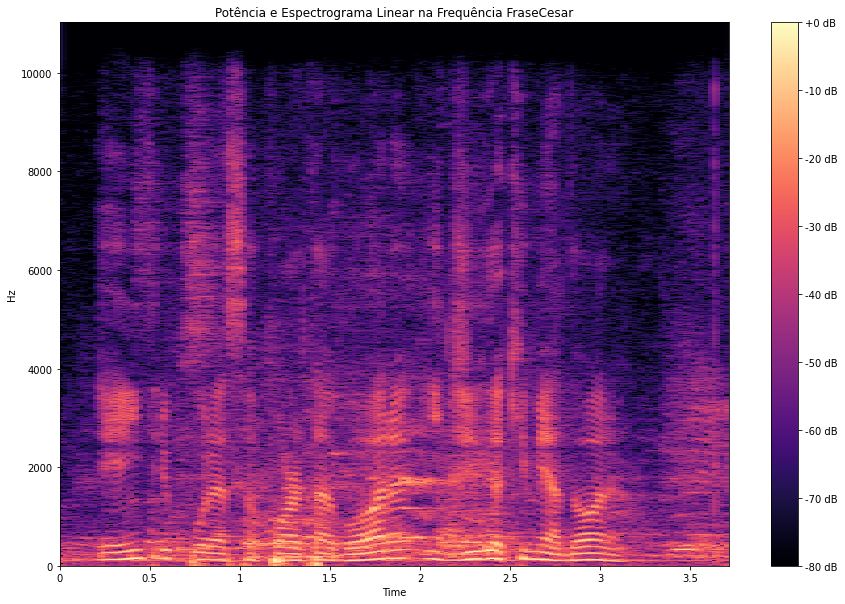

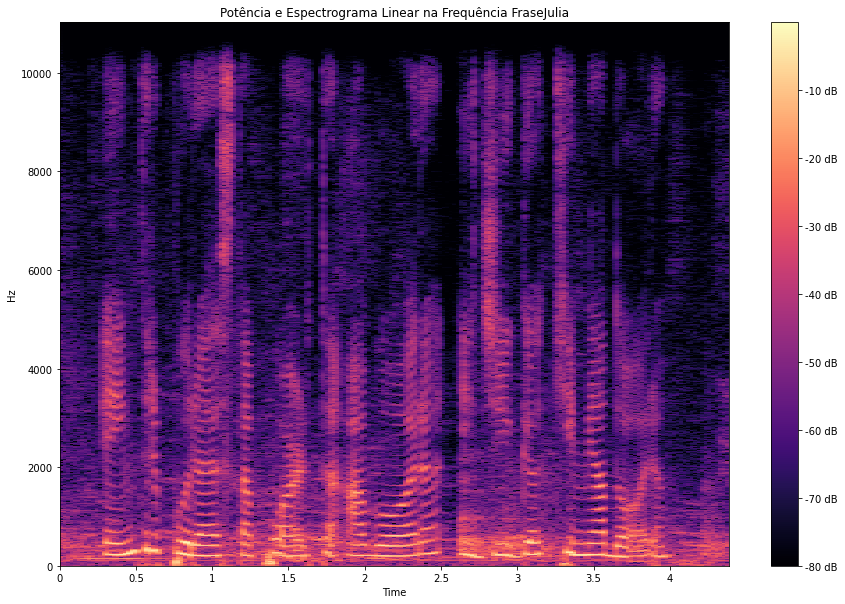

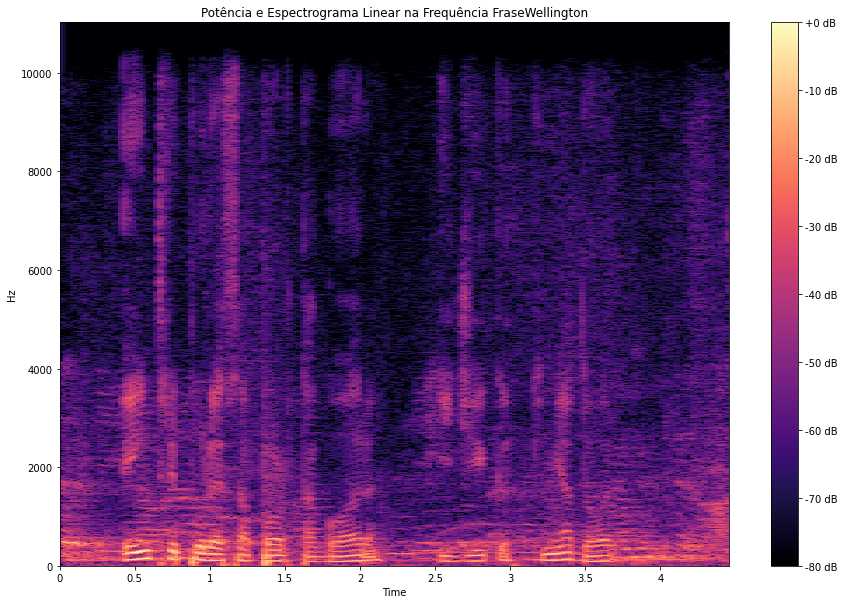

In [ ]:
plot_especto(audioVFArtur)
plot_especto(audioVFEric)
plot_especto(audioVFCesar)
plot_especto(audioVFJulia)
plot_especto(audioVFWell)

#### 4.2.3 Espectograma da Voz Declamada


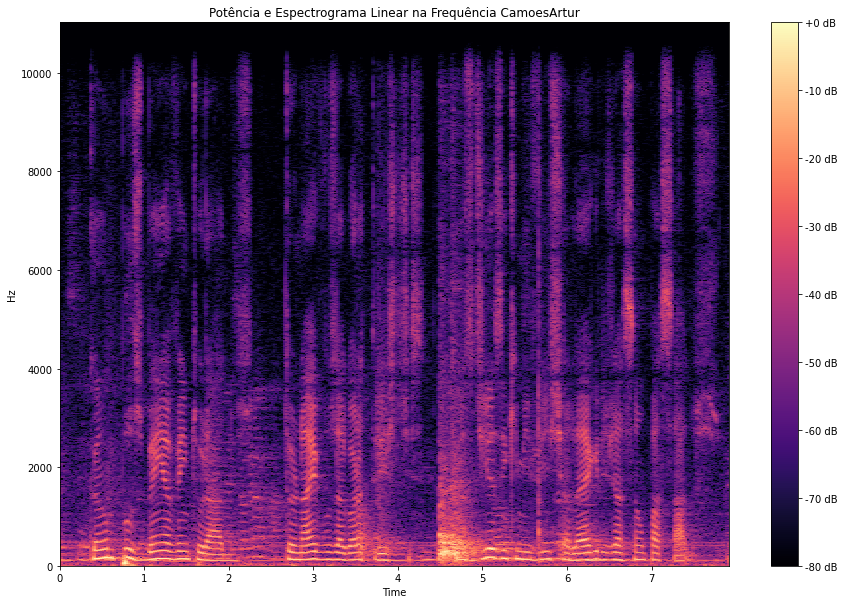

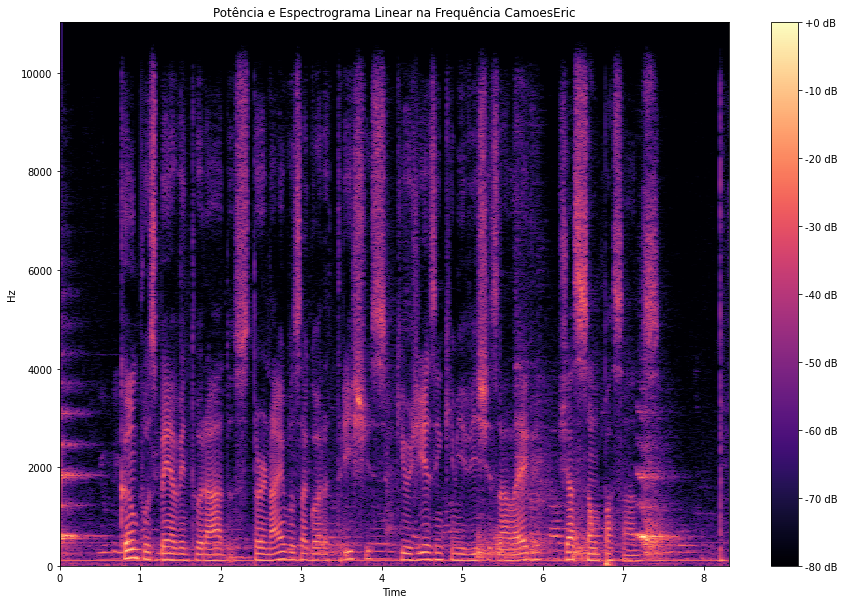

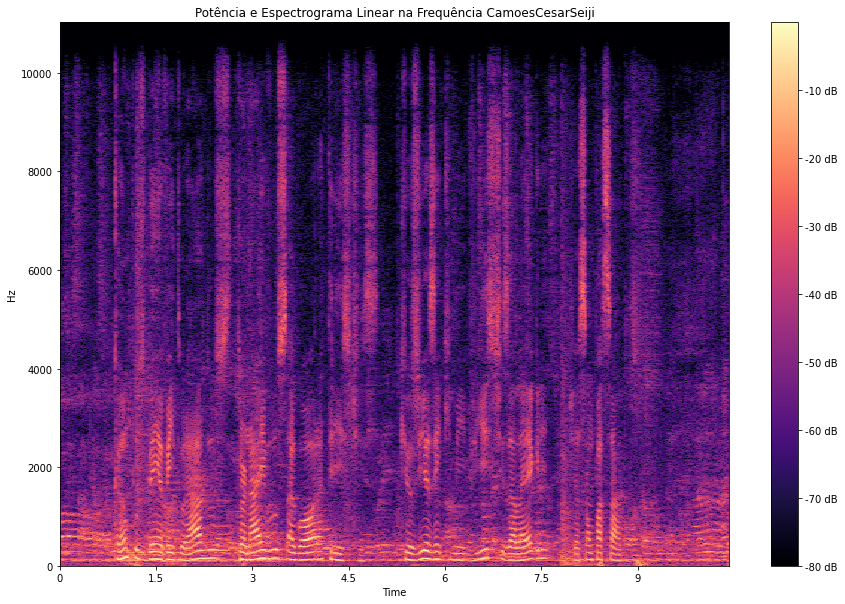

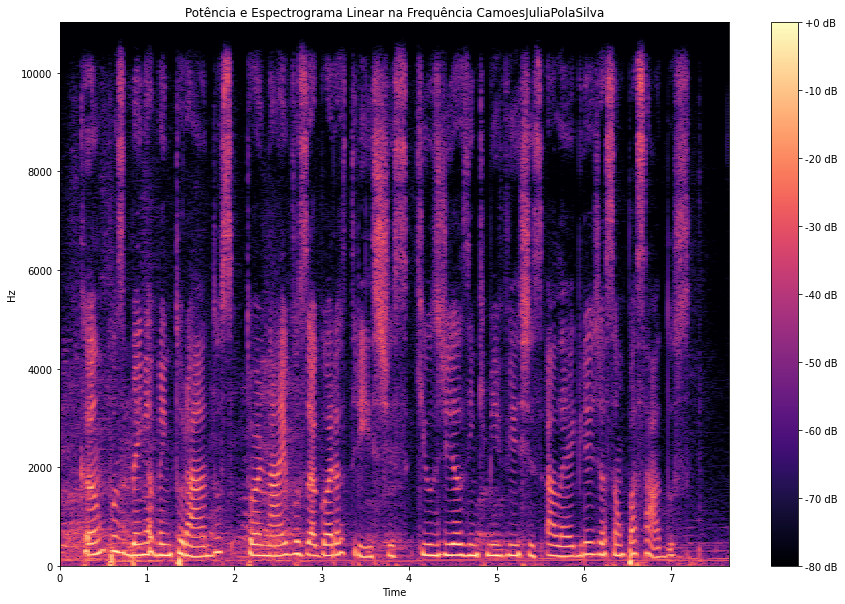

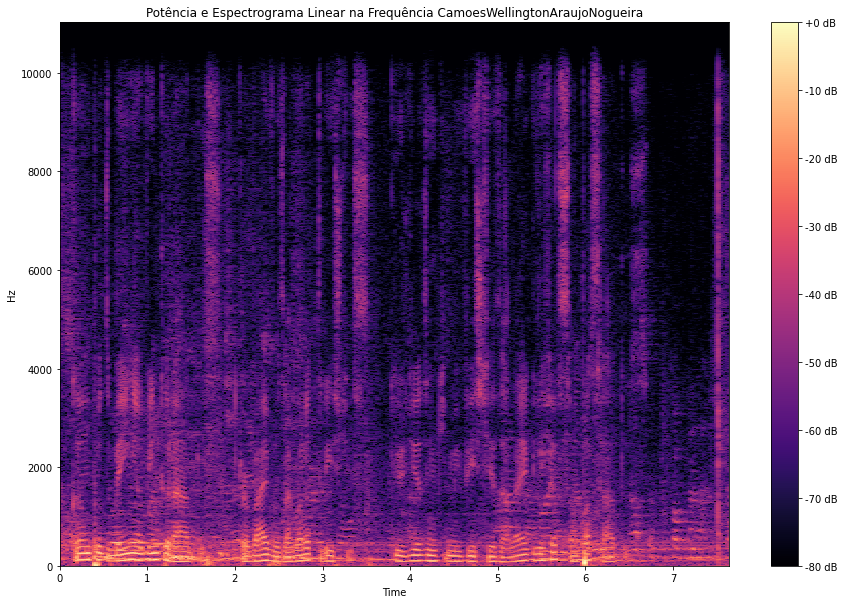

In [ ]:
plot_especto(audioVDArtur)
plot_especto(audioVDEric)
plot_especto(audioVDCesar)
plot_especto(audioVDJulia)
plot_especto(audioVDWell)

##<h2> 5. Determinação do Pitch e da F0 </h2>

### 5.1 Pitch do Arquivo Teste1

In [ ]:
# Segmente um fonema que tenha Pitch, p.ex "En" de "Entre"
v1En = v1[4000:16000]
IPython.display.Audio(data=v1En, rate=sr1)


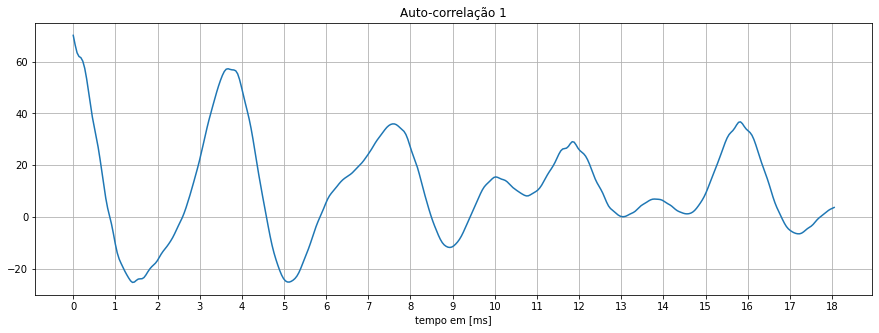

In [ ]:
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter, AutoMinorLocator)
acEn = librosa.autocorrelate(v1En, max_size= sr1/32)
fig, ax = plt.subplots(figsize=(15, 5))
ax.xaxis.set_major_locator(MultipleLocator(1))
y1 = acEn[1:400]
x1 = range(len(y1))
xx = [i*1000/sr1 for i in x1]
plt.grid(True)
ax.plot(xx,y1)

plt.title('Auto-correlação 1')
plt.xlabel('tempo em [ms]')
plt.show()

### O Período de Pitch ($T_{0}$) será o intervalo entre picos sucessivos. 
### A Frequência Fundamental ($f_0$) será o inverso do periódo de Pitch

### 5.2 Pitch do Arquivo Teste2

In [ ]:
# Segmente outro fonema que tenha Pitch, p.ex "Ag" de "Agora"
v1A = v1[48000:56000]
IPython.display.Audio(data=v1A, rate=sr1)

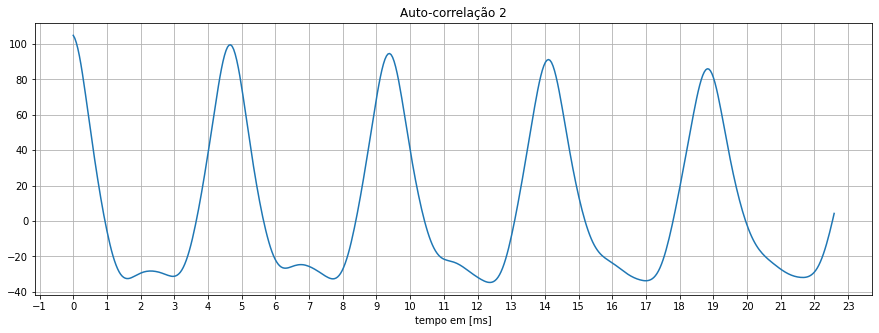

In [ ]:
acA = librosa.autocorrelate(v1A, max_size= sr1/32)
fig, ax2 = plt.subplots(figsize=(15, 5))
ax2.xaxis.set_major_locator(MultipleLocator(1))
y2 = acA[1:500]
x2 = range(len(y2))
xx2 = [i*1000/sr1 for i in x2]
plt.grid(True)
ax2.plot(xx2,y2)

plt.title('Auto-correlação 2')
plt.xlabel('tempo em [ms]')
plt.show()

###Determine o Período de Pitch e a Fundamental desta vogal. 

### Agora com cada um dos seus arquivos: 
**Determine o Pitch e a $f_0$ das vogais que desejarem (três vogais diferentes) dos seus arquivos, para as versões:**
1. Dígitos
2. Falada
3. *Declamada*

###5.3 Periodo de Pitch para arquivos proprios

In [ ]:
def pitch(audio, fonema, Vogal, distancia):
    acEn = librosa.autocorrelate(Vogal, max_size= audio[2]/32)
    fig, ax = plt.subplots(figsize=(15, 5))
    ax.xaxis.set_major_locator(MultipleLocator(1))
    y1 = acEn[1:400]
    x1 = range(len(y1))
    xx = [i*1000/audio[2] for i in x1]
    plt.grid(True)
    ax.plot(xx,y1)

    peaks, _ = signal.find_peaks(y1, distance=distancia)
    plt.plot(peaks*1000/audio[2], y1[peaks], "x")
    T0 = np.diff(peaks*1000/audio[2])[0]
    f0 = 1/T0 * 1000
    print(f'T0 = {T0} ms')
    print(f'f0 = {f0} Hz')

    plt.title(f'Auto-correlação - {audio[0]} - /{fonema}/')
    plt.xlabel('tempo em [ms]')
    plt.show()

### 5.3.1 - Digitos

####Separação dos numeros na voz com digitos

In [ ]:
audioDigArtur_vogal = audioDigArtur[1][10000:24000]
IPython.display.Audio(data=audioDigArtur_vogal, rate=audioDigArtur[2])

T0 = 5.759637188208616 ms
f0 = 173.6220472440945 Hz


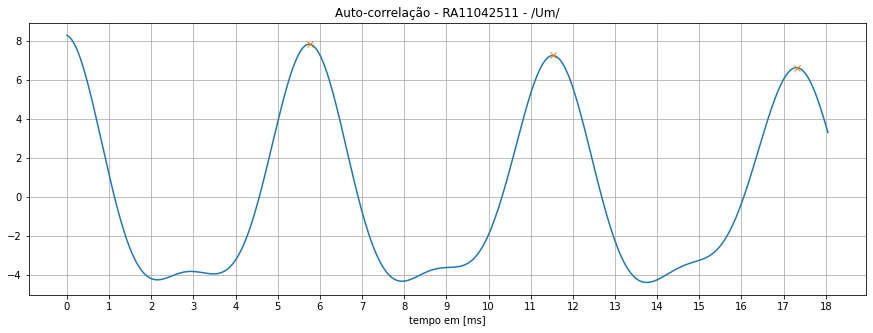

In [ ]:
pitch(audioDigArtur, 'Um', audioDigArtur_vogal, 100)

In [ ]:
audioDigEric_vogal = audioDigEric[1][12000:25000]
IPython.display.Audio(data=audioDigEric_vogal, rate=audioDigEric[2])

T0 = 6.4852607709750565 ms
f0 = 154.1958041958042 Hz


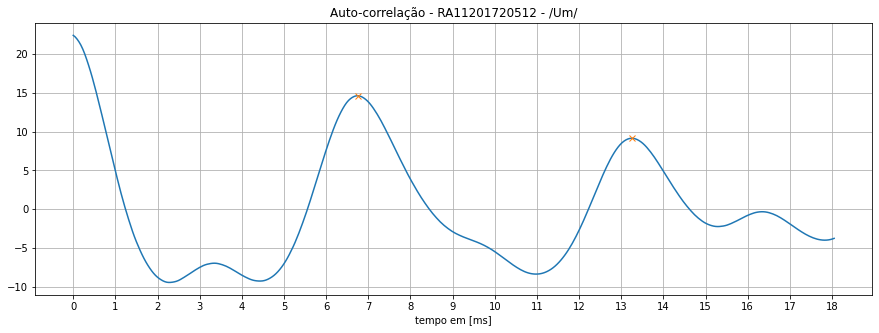

In [ ]:
pitch(audioDigEric, 'Um', audioDigEric_vogal, 100)

In [ ]:
audioDigCesar_vogal = audioDigCesar[1][9000:22000]
IPython.display.Audio(data=audioDigCesar_vogal, rate=audioDigCesar[2])

T0 = 7.029478458049886 ms
f0 = 142.25806451612905 Hz


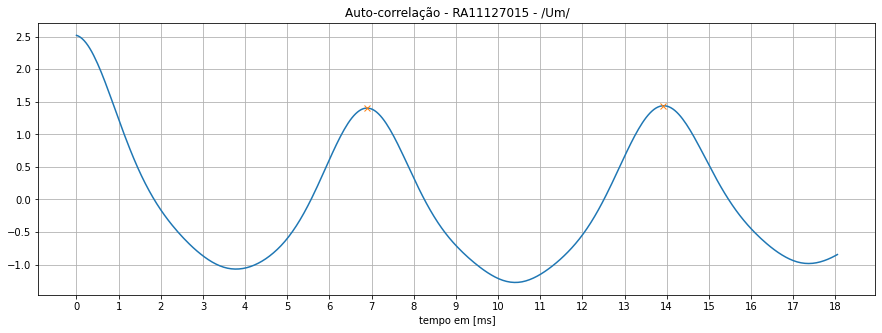

In [ ]:
pitch(audioDigCesar, 'Um', audioDigCesar_vogal, 100)

In [ ]:
audioDigJulia_vogal = audioDigJulia[1][18000:30000]
IPython.display.Audio(data=audioDigJulia_vogal, rate=audioDigJulia[2])

T0 = 4.535147392290249 ms
f0 = 220.5 Hz


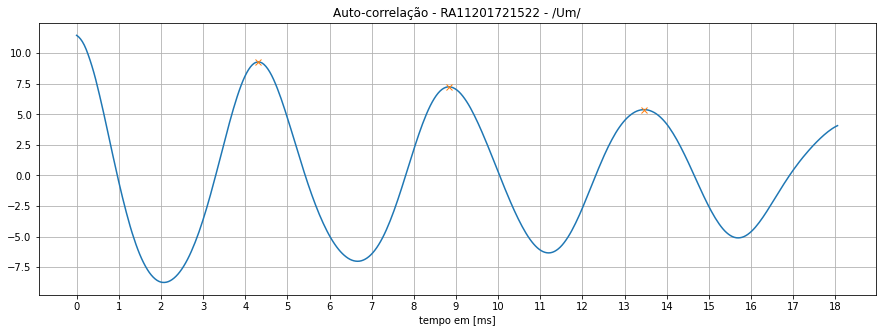

In [ ]:
pitch(audioDigJulia, 'Um', audioDigJulia_vogal, 100)

In [ ]:
audioDigWell_vogal = audioDigWell[1][10000:27000]
IPython.display.Audio(data=audioDigWell_vogal, rate=audioDigWell[2])

T0 = 7.210884353741497 ms
f0 = 138.67924528301887 Hz


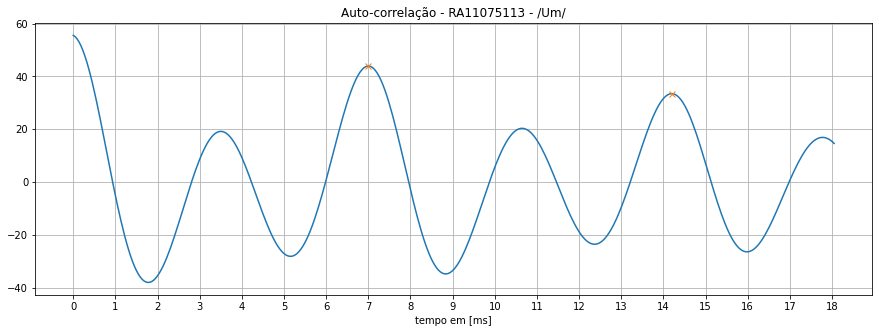

In [ ]:
pitch(audioDigWell, 'Um', audioDigWell_vogal, 100)

### 5.3.2 - Voz Falada

####Separação da fonema com a voz falada "En" de "Entre por esta porta"

In [ ]:
audioVFArtur_vogal = audioVFArtur[1][10000:20000]
IPython.display.Audio(data=audioVFArtur_vogal, rate=audioVFArtur[2])

T0 = 5.532879818594104 ms
f0 = 180.7377049180328 Hz


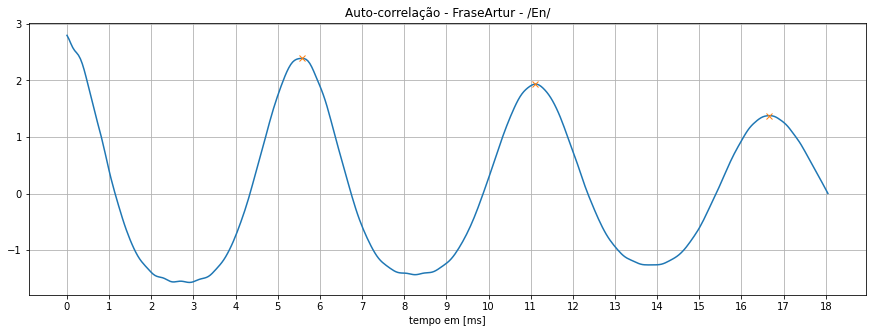

In [ ]:
pitch(audioVFArtur, 'En', audioVFArtur_vogal, 100)

In [ ]:
audioVFEric_vogal = audioVFEric[1][12000:20000]
IPython.display.Audio(data=audioVFEric_vogal, rate=audioVFEric[2])

T0 = 5.532879818594104 ms
f0 = 180.7377049180328 Hz


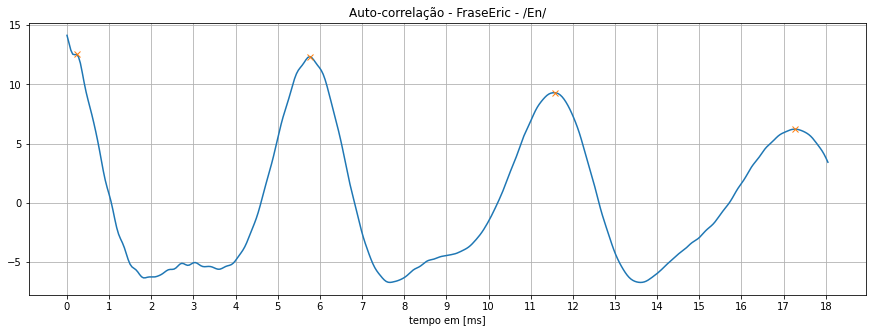

In [ ]:
pitch(audioVFEric, 'En', audioVFEric_vogal, 100)

In [ ]:
audioVFCesar_vogal = audioVFCesar[1][3000:11000]
IPython.display.Audio(data=audioVFCesar_vogal, rate=audioVFCesar[2])

T0 = 6.303854875283447 ms
f0 = 158.63309352517985 Hz


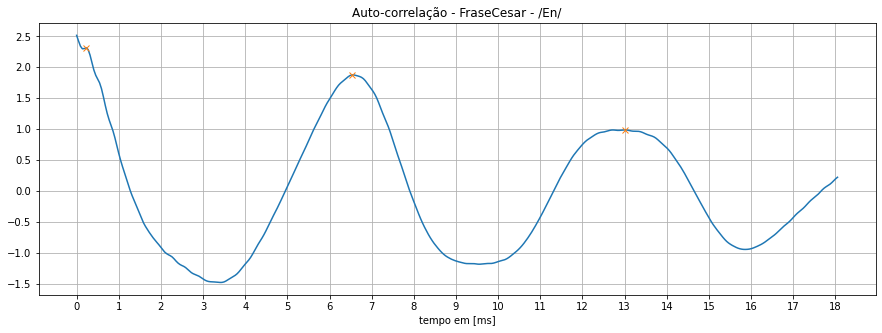

In [ ]:
pitch(audioVFCesar, 'En', audioVFCesar_vogal, 100)

In [ ]:
audioVFJulia_vogal = audioVFJulia[1][2000:11000]
IPython.display.Audio(data=audioVFJulia_vogal, rate=audioVFJulia[2])

T0 = 8.707482993197278 ms
f0 = 114.84375000000001 Hz


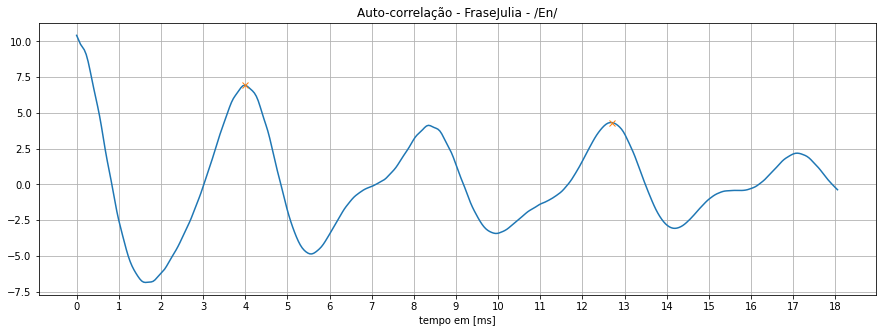

In [ ]:
pitch(audioVFJulia, 'En', audioVFJulia_vogal, 100)

In [ ]:
audioVFWell_vogal = audioVFWell[1][10000:13000]
IPython.display.Audio(data=audioVFWell_vogal, rate=audioVFWell[2])

T0 = 6.666666666666666 ms
f0 = 150.00000000000003 Hz


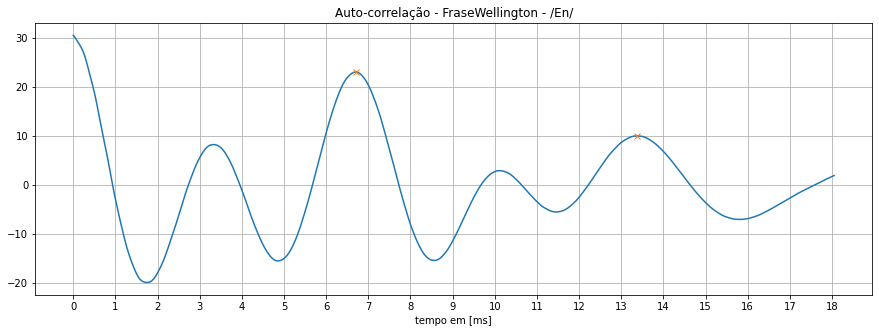

In [ ]:
pitch(audioVFWell, 'En', audioVFWell_vogal, 100)

### 5.3.3 - Voz Declamada

####Separação da fonema com a voz Declamada "Bem"

In [ ]:
audioVDArtur_vogal = audioVDArtur[1][21000:26000]
IPython.display.Audio(data=audioVDArtur_vogal, rate=audioVDArtur[2])

T0 = 6.757369614512471 ms
f0 = 147.98657718120808 Hz


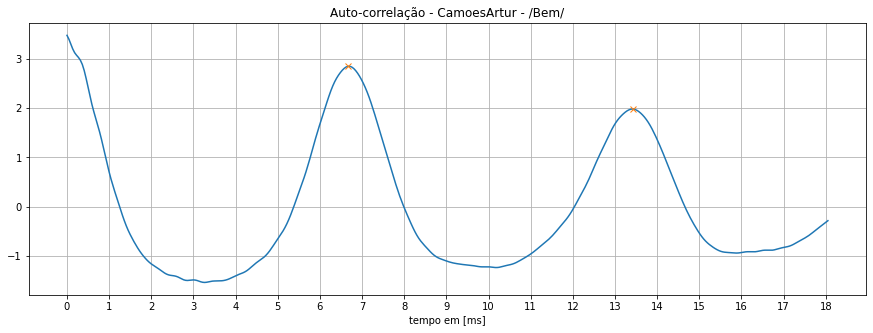

In [ ]:
pitch(audioVDArtur, 'Bem', audioVDArtur_vogal, 100)

In [ ]:
audioVDEric_vogal = audioVDEric[1][26000:30500]
IPython.display.Audio(data=audioVDEric_vogal, rate=audioVDEric[2])

T0 = 7.210884353741497 ms
f0 = 138.67924528301887 Hz


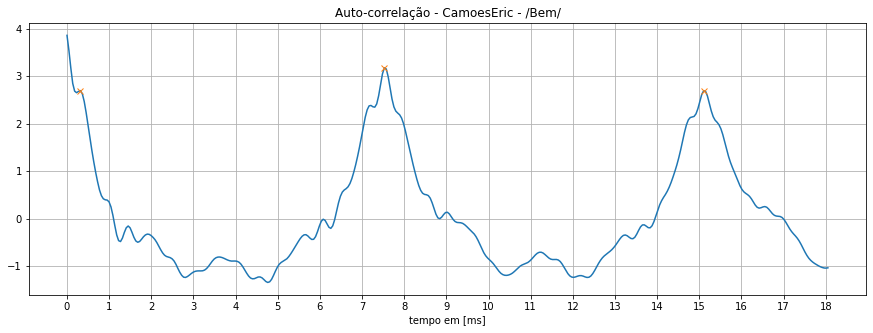

In [ ]:
pitch(audioVDEric, 'Bem', audioVDEric_vogal, 100)

In [ ]:
audioVDCesar_vogal = audioVDCesar[1][28000:35000]
IPython.display.Audio(data=audioVDCesar_vogal, rate=audioVDCesar[2])

T0 = 6.712018140589569 ms
f0 = 148.98648648648648 Hz


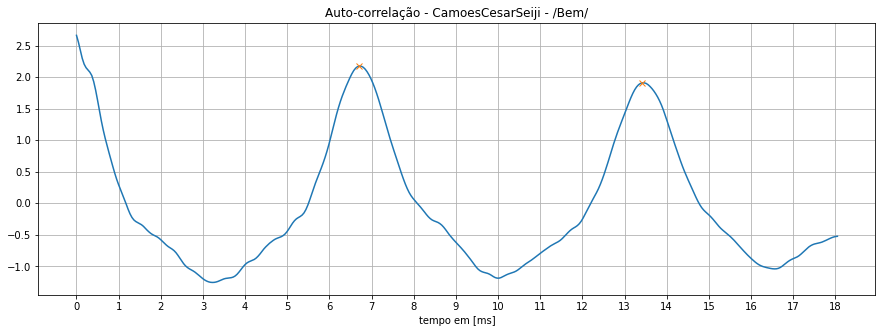

In [ ]:
pitch(audioVDCesar, 'Bem', audioVDCesar_vogal, 100)

In [ ]:
audioVDJulia_vogal = audioVDJulia[1][16000:22000]
IPython.display.Audio(data=audioVDJulia_vogal, rate=audioVDJulia[2])

T0 = 8.843537414965986 ms
f0 = 113.07692307692308 Hz


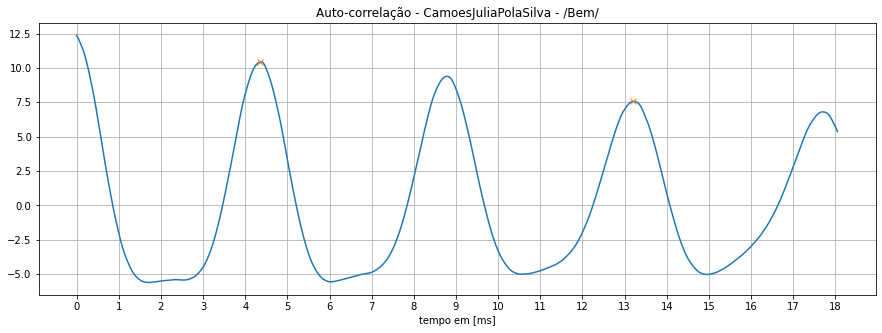

In [ ]:
pitch(audioVDJulia, 'Bem', audioVDJulia_vogal, 100)

In [ ]:
audioVDWell_vogal = audioVDWell[1][13000:19000]
IPython.display.Audio(data=audioVDWell_vogal, rate=audioVDWell[2])

T0 = 5.986394557823129 ms
f0 = 167.04545454545456 Hz


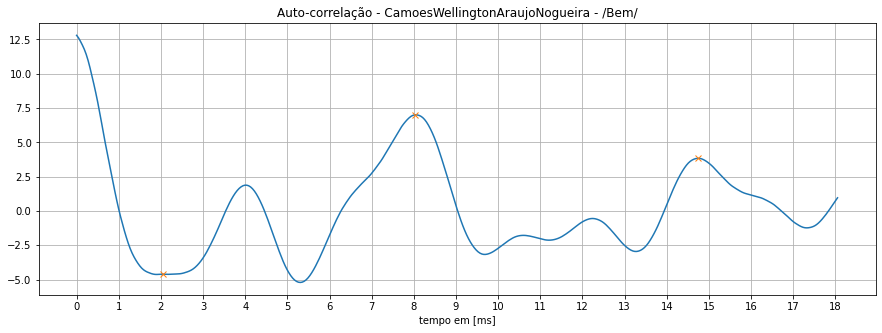

In [ ]:
pitch(audioVDWell, 'Bem', audioVDWell_vogal, 100)

### 5.3 Determinação das Formantes 

#### 5.3.a Formantes do trecho de teste

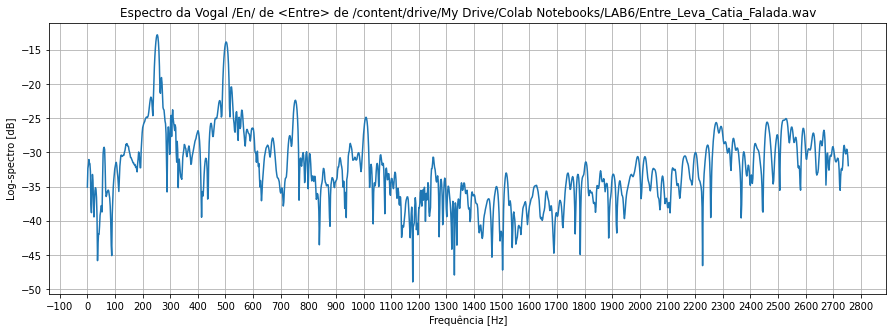

In [ ]:
# AUDIO DE "En" em v1En
f, Pxx_spec = signal.periodogram(v1En, fa, 'flattop', scaling='spectrum')
lf = len(f)
fig, AX = plt.subplots(figsize=(15, 5))
AX.xaxis.set_major_locator(MultipleLocator(100))
AX.plot(f[:int(lf/4)], 10*np.log10(np.sqrt(Pxx_spec[:int(lf/4)])))
plt.xlabel('Frequência [Hz]')
plt.ylabel('Log-spectro [dB]')
plt.title('Espectro da Vogal /En/ de <Entre> de '+audio1)
plt.grid(True)
plt.show()


#### 5.3.1 Formantes do trecho do digito "1"

In [ ]:
# Funcao para facilitar o espectro de um trecho
def espectro_trecho(audio,fonema,x,y):
  f, Pxx_spec = signal.periodogram(fonema, audio[2], 'flattop', scaling='spectrum')
  lf = len(f)
  fig, AX = plt.subplots(figsize=(15, 5))
  y1= 10*np.log10(np.sqrt(Pxx_spec[:int(lf/8)]))
  x1=f[:int(lf/8)]
  AX.xaxis.set_major_locator(MultipleLocator(100))
  AX.plot(x1, y1)

  AX.scatter(x,y, s=200, color='r', marker='o')
    
  print(f'f1: {x[0]} Hz')
  print(f'f2: {x[1]} Hz')
  print(f'f3: {x[2]} Hz')
  print(f'f4: {x[3]} Hz')
  plt.xlabel('Frequência [Hz]')
  plt.ylabel('Log-spectro [dB]')
  plt.title('Espectro da Vogal /En/ de <Entre> de '+ audio[0])
  plt.grid(True)
  plt.show()


f1: 175 Hz
f2: 343 Hz
f3: 530 Hz
f4: 665 Hz


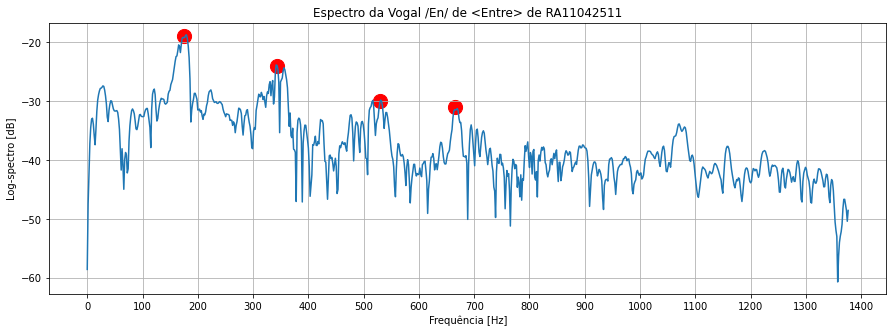

f1: 150 Hz
f2: 301 Hz
f3: 454 Hz
f4: 610 Hz


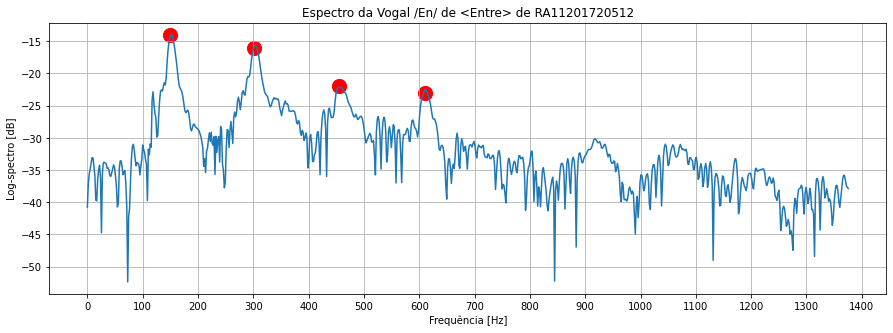

f1: 144 Hz
f2: 287 Hz
f3: 430 Hz
f4: 570 Hz


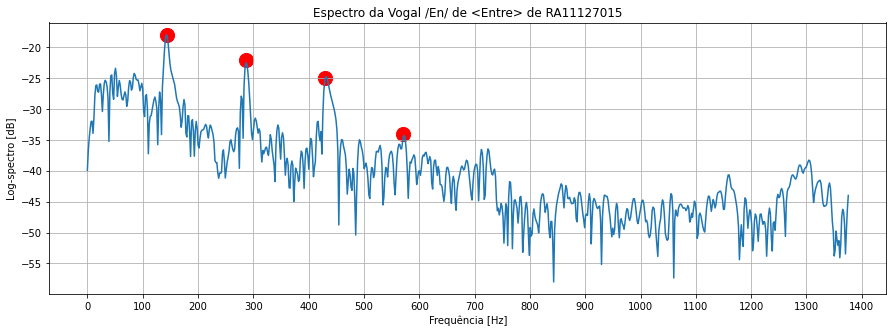

f1: 215 Hz
f2: 430 Hz
f3: 705 Hz
f4: 855 Hz


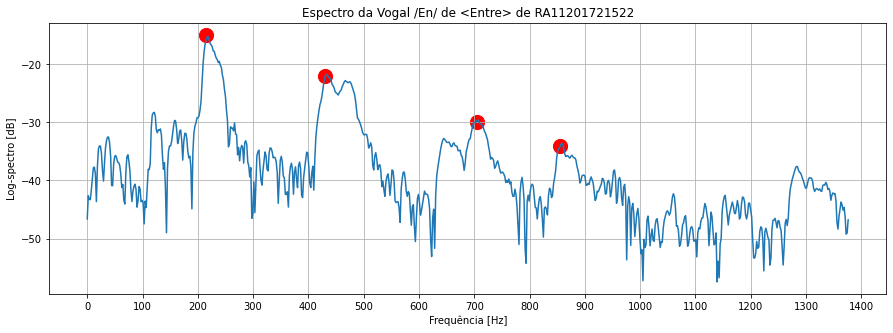

f1: 155 Hz
f2: 285 Hz
f3: 450 Hz
f4: 550 Hz


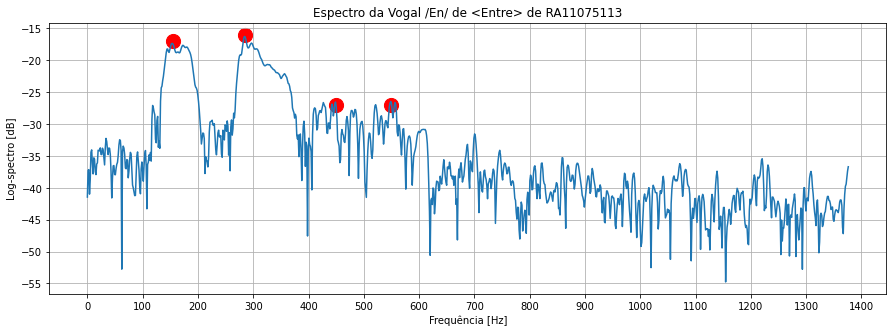

In [ ]:
#Necessario colocar os pontos na mão pois não rodou o findpeak
espectro_trecho(audioDigArtur,audioDigArtur_vogal,[175,343,530,665],[-19,-24,-30,-31])
espectro_trecho(audioDigEric,audioDigEric_vogal,[150,301,454,610],[-14,-16,-22,-23])
espectro_trecho(audioDigCesar,audioDigCesar_vogal,[144,287,430,570],[-18,-22,-25,-34])
espectro_trecho(audioDigJulia,audioDigJulia_vogal,[215,430,705,855],[-15,-22,-30,-34])
espectro_trecho(audioDigWell,audioDigWell_vogal,[155,285,450,550],[-17,-16,-27,-27])

f1: 175 Hz
f2: 343 Hz
f3: 445 Hz
f4: 560 Hz


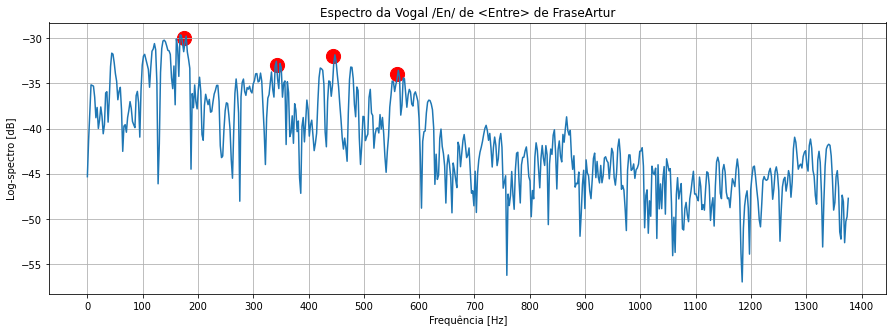

f1: 165 Hz
f2: 330 Hz
f3: 495 Hz
f4: 660 Hz


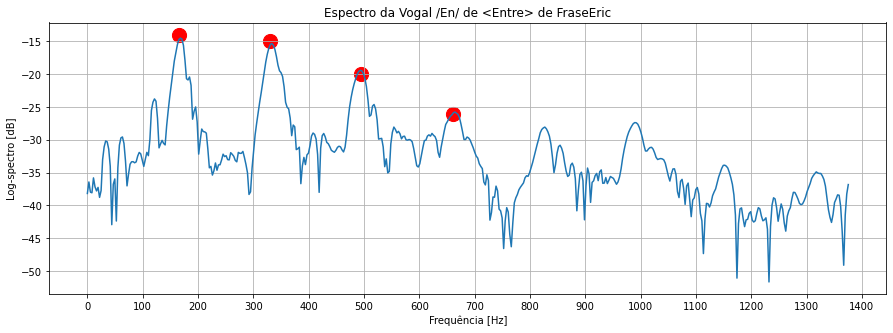

f1: 144 Hz
f2: 285 Hz
f3: 420 Hz
f4: 570 Hz


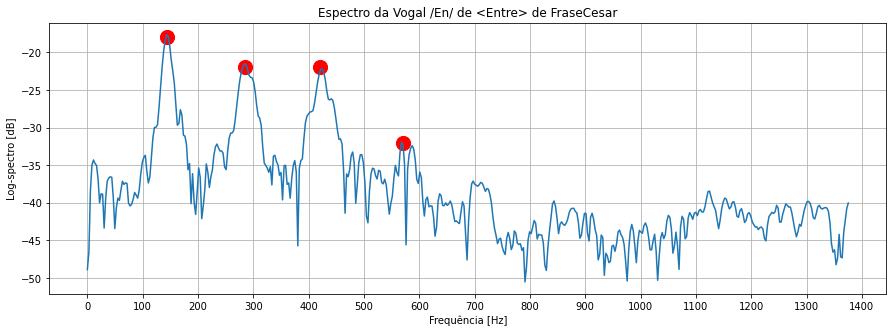

f1: 235 Hz
f2: 470 Hz
f3: 705 Hz
f4: 945 Hz


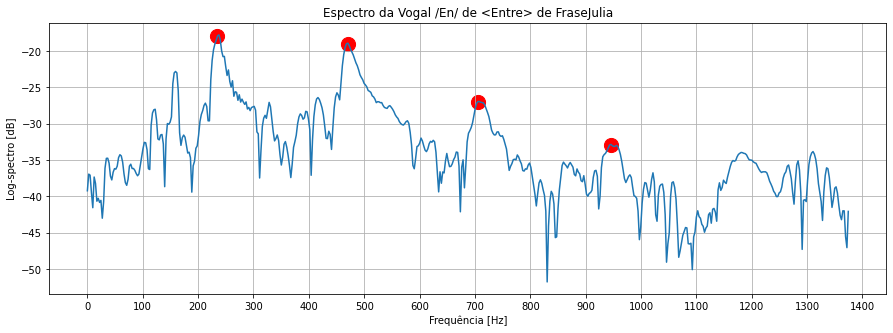

f1: 150 Hz
f2: 295 Hz
f3: 440 Hz
f4: 515 Hz


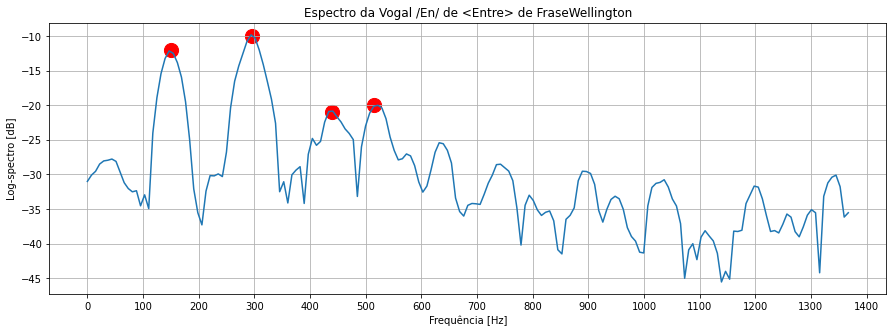

In [ ]:
#Necessario colocar os pontos na mão pois não rodou o findpeak
espectro_trecho(audioVFArtur,audioVFArtur_vogal,[175,343,445,560],[-30,-33,-32,-34])
espectro_trecho(audioVFEric,audioVFEric_vogal,[165,330,495,660],[-14,-15,-20,-26])
espectro_trecho(audioVFCesar,audioVFCesar_vogal,[144,285,420,570],[-18,-22,-22,-32])
espectro_trecho(audioVFJulia,audioVFJulia_vogal,[235,470,705,945],[-18,-19,-27,-33])
espectro_trecho(audioVFWell,audioVFWell_vogal,[150,295,440,515],[-12,-10,-21,-20])

f1: 140 Hz
f2: 290 Hz
f3: 430 Hz
f4: 580 Hz


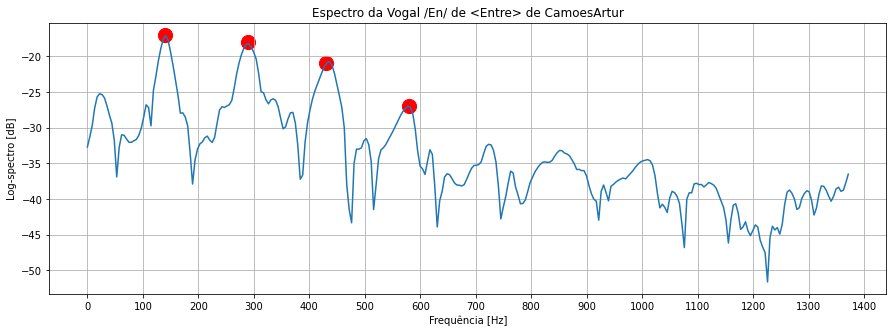

f1: 130 Hz
f2: 260 Hz
f3: 400 Hz
f4: 520 Hz


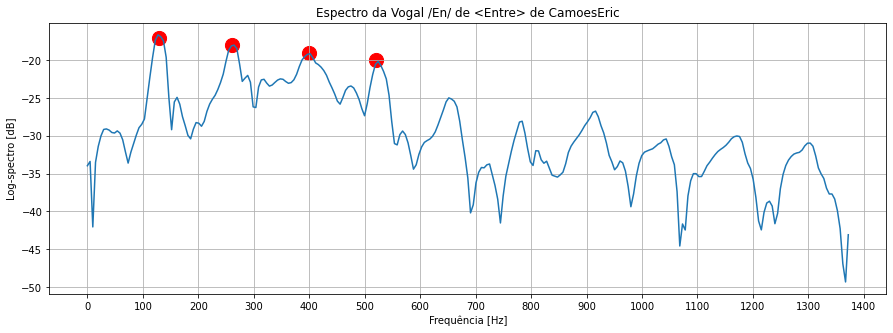

f1: 144 Hz
f2: 295 Hz
f3: 445 Hz
f4: 590 Hz


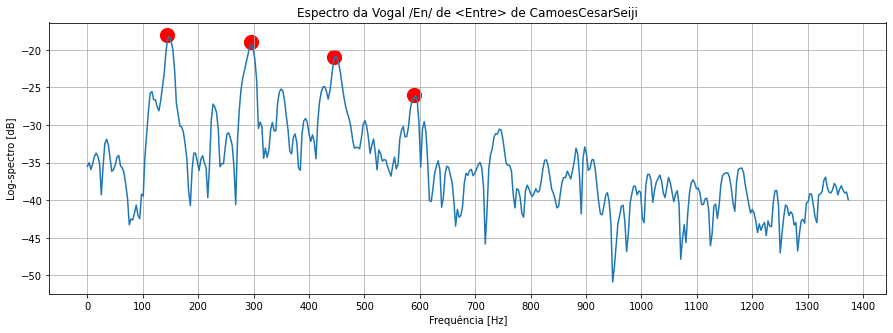

f1: 220 Hz
f2: 450 Hz
f3: 670 Hz
f4: 890 Hz


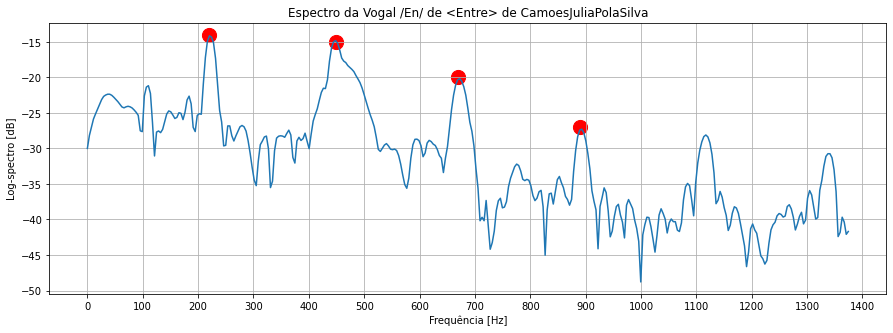

f1: 120 Hz
f2: 240 Hz
f3: 315 Hz
f4: 485 Hz


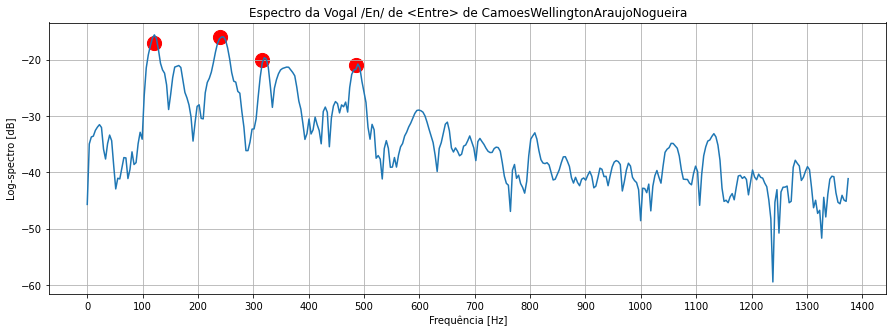

In [ ]:
#Necessario colocar os pontos na mão pois não rodou o findpeak
espectro_trecho(audioVDArtur,audioVDArtur_vogal,[140,290,430,580],[-17,-18,-21,-27])
espectro_trecho(audioVDEric,audioVDEric_vogal,[130,260,400,520],[-17,-18,-19,-20])
espectro_trecho(audioVDCesar,audioVDCesar_vogal,[144,295,445,590],[-18,-19,-21,-26])
espectro_trecho(audioVDJulia,audioVDJulia_vogal,[220,450,670,890],[-14,-15,-20,-27])
espectro_trecho(audioVDWell,audioVDWell_vogal,[120,240,315,485],[-17,-16,-20,-21])

#### Os quatro primeros picos no espectro são as formantes $f_1$ a $f_4$


## 6. Determinação de Consoantes e Plosivos

Usando alguns de seus arquivos, no espectrograma, determine algumas consoantes surdas (p.ex. /s/ e /f/), surdas plosivas (p.ex. /p/, /t/ ou /k/) e sonoras (p.ex. (/b/, /v/, /g/, /m/, /nh/ e /lh/). Destaque circundando-as no espectrograma.

In [ ]:
audioVFArtur_Cons = audioVFArtur[1][32000:33000]
IPython.display.Audio(data=audioVFArtur_Cons, rate=audioVFArtur[2])

Text(0.5, 1.0, 'Potência e Espectrograma Linear na Frequência FraseArturcom consoante surda /s/')

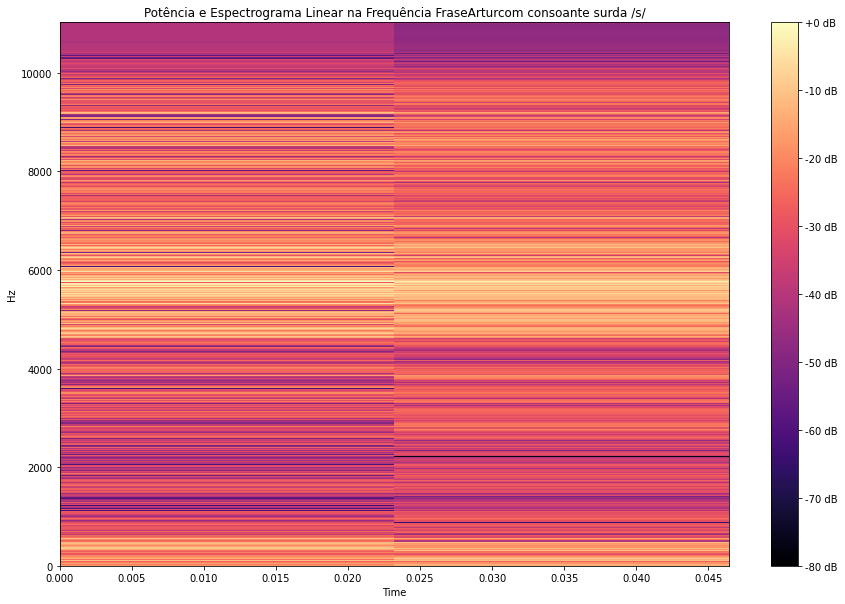

In [ ]:
D = librosa.amplitude_to_db(np.abs(librosa.stft(audioVFArtur_Cons)), ref=np.max)
fig, ax = plt.subplots(figsize=(15, 10))
librosa.display.specshow(D, x_axis='time',y_axis='linear')
plt.colorbar(format='%+2.0f dB')
plt.title('Potência e Espectrograma Linear na Frequência '+ audioVFArtur[0] + 'com consoante surda /s/')

In [ ]:
audioVFArtur_Plos = audioVFArtur[1][36000:39000]
IPython.display.Audio(data=audioVFArtur_Plos, rate=audioVFArtur[2])

Text(0.5, 1.0, 'Potência e Espectrograma Linear na Frequência FraseArturcom consoante surda plosiva /p/')

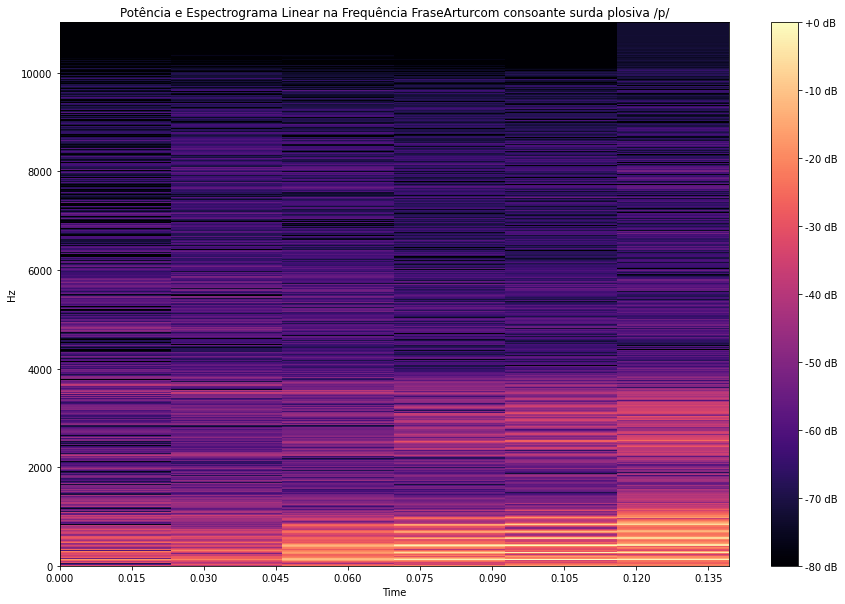

In [ ]:
D = librosa.amplitude_to_db(np.abs(librosa.stft(audioVFArtur_Plos)), ref=np.max)
fig, ax = plt.subplots(figsize=(15, 10))
librosa.display.specshow(D, x_axis='time',y_axis='linear')
plt.colorbar(format='%+2.0f dB')
plt.title('Potência e Espectrograma Linear na Frequência '+ audioVFArtur[0] + 'com consoante surda plosiva /p/')

In [ ]:
audioVFArtur_Sono = audioVFArtur[1][83000:84500]
IPython.display.Audio(data=audioVFArtur_Sono, rate=audioVFArtur[2])

/usr/local/lib/python3.8/dist-packages/librosa/core/spectrum.py:222: UserWarning: n_fft=2048 is too small for input signal of length=1500
  warnings.warn(


Text(0.5, 1.0, 'Potência e Espectrograma Linear na Frequência CamoesArturcom consoante sonora /s/')

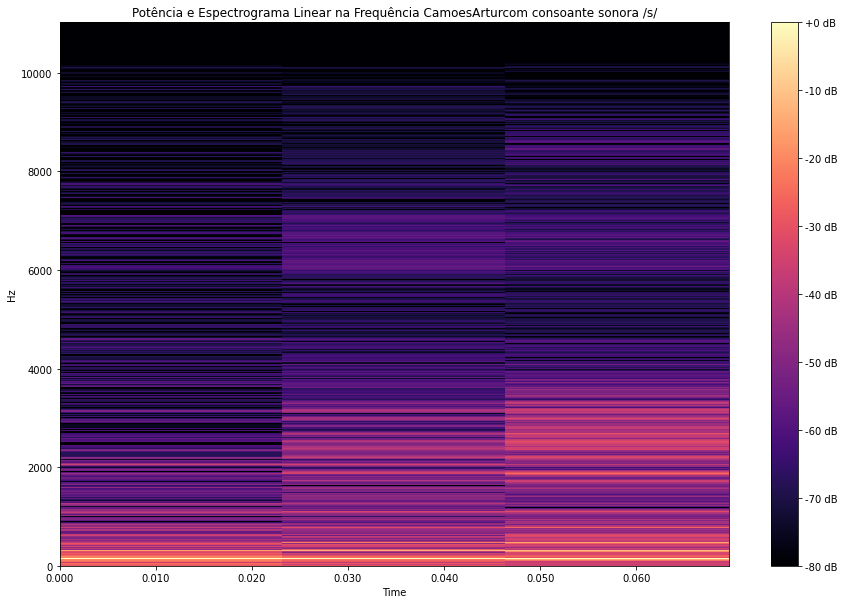

In [ ]:
D = librosa.amplitude_to_db(np.abs(librosa.stft(audioVFArtur_Sono)), ref=np.max)
fig, ax = plt.subplots(figsize=(15, 10))
librosa.display.specshow(D, x_axis='time',y_axis='linear')
plt.colorbar(format='%+2.0f dB')
plt.title('Potência e Espectrograma Linear na Frequência '+ audioVDArtur[0] + 'com consoante sonora /s/')

# 7. Conclusões

* A áudio descrição pode ser mais simplificada, pois neste Lab são muitos os arquivos de áudio.  
* Na página do Laboratório (LEMBREM-SE que os notebooks são ANEXOS, e não páginas html), incluir os arquivos de voz de cada um dos integrantes.
*   Fazer uma tabela com todos os valores de pitch e $f_0$ de todos os integrantes, de acordo com o item 5.2., e comparem-nas.
* Escolher um conjunto de formantes ($f_1$ a $f_4$) de cada integrante, para a mesma vogal, e comparem-nas.
* Fazer uma seção de **Comentários e Conclusões** incluindo a análise dos espectrogramas das consoantes.



<style type="text/css">
	table.tableizer-table {
		font-size: 12px;
		border: 1px solid #CCC; 
		font-family: Arial, Helvetica, sans-serif;
	} 
	.tableizer-table td {
		padding: 4px;
		margin: 3px;
		border: 1px solid #CCC;
	}
	.tableizer-table th {
		background-color: #104E8B; 
		color: #FFF;
		font-weight: bold;
	}
</style>
<table class="tableizer-table">
<thead><tr class="tableizer-firstrow"><th>Integrante</th><th>f0</th><th>f1</th><th>f2</th><th>f3</th></tr></thead><tbody>
 <tr><td>Artur</td><td>175</td><td>343</td><td>530</td><td>665</td></tr>
 <tr><td>Eric</td><td>150</td><td>301</td><td>454</td><td>610</td></tr>
 <tr><td>Cesar</td><td>144</td><td>287</td><td>430</td><td>570</td></tr>
 <tr><td>Julia</td><td>215</td><td>430</td><td>705</td><td>855</td></tr>
 <tr><td>Wellington</td><td>155</td><td>450</td><td>450</td><td>550</td></tr>
</tbody></table>



---

